In [1]:
# TODO: get properties of n+1-neighbors: a) aromaticity chain, b) electrophilicity chain, c) hybridization chain? d) ...
# IBOview
import ipywidgets as widgets
import matplotlib.pyplot as plt
import csv
from typing import Sequence
import json
from contextlib import ExitStack
from operator import itemgetter
import logging
from rdkit import Chem
from rdkit.Chem import Draw
from rdkit.Chem import rdDetermineBonds
from rdkit.Chem.rdmolops import GetDistanceMatrix, GetShortestPath
from rdkit.Chem.rdchem import BondType
from copy import deepcopy
from copy import copy as shallowcopy
from collections import Counter
import seaborn as sns
import numpy as np
import random

_log = logging.getLogger(__name__)
logging.basicConfig(level = logging.WARNING)
#_log.setLevel(logging.DEBUG)
_log.setLevel(logging.WARNING)
logging.getLogger("PIL").setLevel(logging.WARNING)

COMPU_LEVEL = "DSDBLYP"
CURR_FIA_TYPE = "gas"
BEST = 100
TOP = .25
CHANNEL_SEARCH_VERSION = 2

In [23]:
def get_info_by(
    info_type: str,
    reader: csv.DictReader,
    fetch_fia_only = False,
    to_fetch: Sequence = ("Compound", f"fia_{CURR_FIA_TYPE}-{COMPU_LEVEL}", "la_smiles", "ca", "atoms_binding_to_central_atom_info"),
    cast_to_float: Sequence = (1,),
    sort = True,
    conjugation_count_summarize = False,
    non_single_count_summarize = False,
    conjugation_count_single_classes = False,
    non_single_count_single_classes = False,
    ligand_atom_counts_group = False,
):
    def fetch_it(row, fetch_fia_only):
        fetched = []
        if fetch_fia_only:
            fetched = float(row[f"fia_{CURR_FIA_TYPE}-{COMPU_LEVEL}"])
        else:
            for tf in to_fetch:
                fetched.append(row[tf])
            for ca in cast_to_float:
                fetched[ca] = float(fetched[ca])
            fetched = tuple(fetched)
        return fetched
        
    info = {}
    match info_type:
        case "channel_start_end_info":
            for row in reader:
                fetched = fetch_it(row, False)
                mol = Chem.MolFromSmiles(fetched[2])
                if CHANNEL_SEARCH_VERSION == 2:
                    channels = get_all_channels_new(mol, fetched[3])
                else:
                    channels = get_all_channels(mol, fetched[3])
                for channel in channels:
                    start_atom_symbol = mol.GetAtomWithIdx(channel.chain[1]).GetSymbol()
                    end_atom_symbol = mol.GetAtomWithIdx(channel.chain[-1]).GetSymbol()
                    key = f"{start_atom_symbol}-{end_atom_symbol}-{">6" if len(channel.chain) > 6 else len(channel.chain)}"
                    if info.get(key, None) is None:
                        info[key] = []
                    if fetch_fia_only:
                        info[key].append(float(fetched[1]))
                    else:
                        info[key].append(fetched)
        case "heteroatom_count":
            for row in reader:
                fetched = fetch_it(row, False)
                mol = Chem.MolFromSmiles(fetched[2])
                count = 0
                for atom in mol.GetAtoms():
                    if atom.GetAtomicNum() not in (1, 6):
                        count += 1
                if info.get(count, None) is None:
                    info[count] = []
                if fetch_fia_only:
                    info[count].append(float(fetched[1]))
                else:
                    info[count].append(fetched)
        case "channel_end_info":
            for row in reader:
                fetched = fetch_it(row, False)
                mol = Chem.MolFromSmiles(fetched[2])
                if CHANNEL_SEARCH_VERSION == 2:
                    channels = get_all_channels_new(mol, fetched[3])
                else:
                    channels = get_all_channels(mol, fetched[3])
                for channel in channels:
                    end_atom_symbol = mol.GetAtomWithIdx(channel.chain[-1]).GetSymbol()
                    key = f"X-{end_atom_symbol}-{channel.conjugated}"
                    if info.get(key, None) is None:
                        info[key] = []
                    if fetch_fia_only:
                        info[key].append(float(fetched[1]))
                    else:
                        info[key].append(fetched)
        case "channel_count":
            for row in reader:
                fetched = fetch_it(row, False)
                mol = Chem.MolFromSmiles(fetched[2])
                if CHANNEL_SEARCH_VERSION == 2:
                    channels = get_all_channels_new(mol, fetched[3])
                else:
                    channels = get_all_channels(mol, fetched[3])
                if info.get(len(channels), None) is None:
                    info[len(channels)] = []
                if fetch_fia_only:
                    info[len(channels)].append(float(fetched[1]))
                else:
                    info[len(channels)].append(fetched)
        case "channel_length":
            for row in reader:
                fetched = fetch_it(row, False)
                mol = Chem.MolFromSmiles(fetched[2])
                if CHANNEL_SEARCH_VERSION == 2:
                    channels = get_all_channels_new(mol, fetched[3])
                else:
                    channels = get_all_channels(mol, fetched[3])
                for channel in channels:
                    if info.get(len(channel.chain), None) is None:
                        info[len(channel.chain)] = []
                    if fetch_fia_only:
                        info[len(channel.chain)].append(float(fetched[1]))
                    else:
                        info[len(channel.chain)].append(fetched)
        case "channel_conjugated":
            for row in reader:
                fetched = fetch_it(row, False)
                mol = Chem.MolFromSmiles(fetched[2])
                if CHANNEL_SEARCH_VERSION == 2:
                    channels = get_all_channels_new(mol, fetched[3])
                else:
                    channels = get_all_channels(mol, fetched[3])
                for channel in channels:
                    if info.get(channel.conjugated, None) is None:
                        info[channel.conjugated] = []
                    if fetch_fia_only:
                        info[channel.conjugated].append(float(fetched[1]))
                    else:
                        info[channel.conjugated].append(fetched)
        case "channel_aromatic":
            for row in reader:
                fetched = fetch_it(row, False)
                mol = Chem.MolFromSmiles(fetched[2])
                if CHANNEL_SEARCH_VERSION == 2:
                    channels = get_all_channels_new(mol, fetched[3])
                else:
                    channels = get_all_channels(mol, fetched[3])
                for channel in channels:
                    if info.get(channel.aromatic, None) is None:
                        info[channel.aromatic] = []
                    if fetch_fia_only:
                        info[channel.aromatic].append(float(fetched[1]))
                    else:
                        info[channel.aromatic].append(fetched)
        case "ligand_info":
            for row in reader:
                fetched = fetch_it(row, fetch_fia_only)
                if info.get(row["ligand_info"], None) is None:
                    info[row["ligand_info"]] = []
                info[row["ligand_info"]].append(fetched)
        case "non_single_count":
            for row in reader:
                mol = Chem.MolFromSmiles(row["la_smiles"])
                properties = query_properties(
                    mol,
                    row["atoms_binding_to_central_atom_info"],
                    row["ca"],
                    print_only = False,
                    smiles_for_error = row["la_smiles"]
                )
                fetched = fetch_it(row, fetch_fia_only)
                if not non_single_count_single_classes:
                    key = Counter()
                else:
                    key = tuple()
                for atom, atom_props in properties.items():
                    non_single_count = 0
                    for neighbor, neighbor_props in atom_props["neighbors"].items():
                        non_single_count += (1 if neighbor_props["non_single"] else 0)
                    if not non_single_count_single_classes:
                        key.update(((atom.GetSymbol(), non_single_count),))
                    else:
                        key = (atom.GetSymbol(), non_single_count)
                        if info.get(key, None) is None:
                            info[key] = []
                        info[key].append(fetched)
                if key is Counter() or key is tuple():
                    key = "None"
                elif not non_single_count_summarize and not non_single_count_single_classes:
                    key = tuple(sorted(key.elements()))
                elif non_single_count_summarize:
                    key = key.total()
                if not non_single_count_single_classes:
                    if info.get(key, None) is None:
                        info[key] = []
                    info[key].append(fetched)
        case "conjugation_count":
            for row in reader:
                mol = Chem.MolFromSmiles(row["la_smiles"])
                properties = query_properties(
                    mol,
                    row["atoms_binding_to_central_atom_info"],
                    row["ca"],
                    print_only = False,
                    smiles_for_error = row["la_smiles"]
                )
                fetched = fetch_it(row, fetch_fia_only)
                if not conjugation_count_single_classes:
                    key = Counter()
                else:
                    key = tuple()
                for atom, atom_props in properties.items():
                    conjugation_count = 0
                    for neighbor, neighbor_props in atom_props["neighbors"].items():
                        conjugation_count += (1 if neighbor_props["conjugated"] else 0)
                    if not conjugation_count_single_classes:
                        key.update(((atom.GetSymbol(), conjugation_count),))
                    else:
                        key = (atom.GetSymbol(), conjugation_count)
                        if info.get(key, None) is None:
                            info[key] = []
                        info[key].append(fetched)
                if key is Counter() or key is tuple():
                    key = "None"
                elif not conjugation_count_summarize and not conjugation_count_single_classes:
                    key = tuple(sorted(key.elements()))
                elif conjugation_count_summarize:
                    key = key.total()
                if not conjugation_count_single_classes:
                    if info.get(key, None) is None:
                        info[key] = []
                    info[key].append(fetched)
        case "ligand_atom_types":
            filenames = (f"FIA49k/FIA49k_0{i}.json" for i in range(1,6))
            #xyzs = {}
            #with ExitStack() as stack:
            #    files = [stack.enter_context(open(fname, "r")) for fname in filenames]
            #    for file in files:
            #        _tmp = json.load(file)
            #        xyzs.update(_tmp)
            for row in reader:
                fetched = fetch_it(row, fetch_fia_only)
                #xyz = xyzs[row["Compound"]][f"la-{COMPU_LEVEL}"]
                parsed = row["atoms_binding_to_central_atom_info"].split("_")
                if ligand_atom_counts_group:
                    # discard number
                    parsed = [pa.split("-")[0] for pa in parsed]
                for pa in parsed:
                    if info.get(pa, None) is None:
                        info[pa] = []
                    info[pa].append(fetched)
        case "ligand_atom_counts":
            for row in reader:
                fetched = fetch_it(row, fetch_fia_only)
                parsed = row["atoms_binding_to_central_atom_info"].split("_")
                import re
                if ligand_atom_counts_group:
                    # discard number
                    parsed = [re.sub('\\(.*\\)', "", pa) for pa in parsed]
                for pa in parsed:
                    if info.get(pa, None) is None:
                        info[pa] = []
                    info[pa].append(fetched)
        case _:
            raise ValueError(f'Info type "{info_type}" not implemented!')
    if sort:
        # sort by key first
        info = dict(sorted(info.items(), reverse = True))
        for li in info.values():
            if isinstance(li[0], Sequence):
                # assume all entries are sequences, where FIA is at position 1
                li.sort(key = itemgetter(1), reverse = True)
            else:
                # assume only FIA is present
                li.sort(reverse = True)
    return info


def query_properties(mol, abtcai: str, ca: str, print_only = True, smiles_for_error = ""):
    try:
        # only atoms, no other info
        ligand_atom_strings = [atom[:atom.find("(")]for atom in abtcai.split("_")]
        if print_only:
            print(f"Central atom: {ca}")
        properties = {}
        # HACK: speaks for itself...
        # needed since [X,x] notation does not work for i.e. Al
        search_string = f"[#{Chem.MolFromSmarts(f"[{ca}]").GetAtomWithIdx(0).GetAtomicNum()}]"
        res = mol.GetSubstructMatch(Chem.MolFromSmarts(search_string))
        if not res:
            raise ValueError(f"Central atom with search string {search_string} not found!")
        ca_index = res[0]
        ligand_atoms = mol.GetAtomWithIdx(ca_index).GetNeighbors()
        for atom in ligand_atoms:
            properties[atom] = {"aromatic": atom.GetIsAromatic(), "neighbors": {}}
            atom_idx = atom.GetIdx()
            if print_only:
                print(f"Is {atom.GetSymbol()}({atom_idx}) aromatic? {"Yes!" if atom.GetIsAromatic() else "No..."}")
            neighbors = atom.GetNeighbors()
            for neighbor in neighbors:
                neighbor_idx = neighbor.GetIdx()
                bond = mol.GetBondBetweenAtoms(atom_idx, neighbor_idx)
                properties[atom]["neighbors"].update(
                    {
                        neighbor: {
                            "symbol": neighbor.GetSymbol(),
                            "conjugated": bond.GetIsConjugated(),
                            "non_single": (bond.GetBondType() != BondType.SINGLE) or bond.GetIsConjugated()
                        }
                    }
                )
                if print_only:
                    print(f"Is {atom.GetSymbol()}-{neighbor.GetSymbol()} ({atom_idx}-{neighbor_idx}) bond conjugated? {"Yes!" if bond.GetIsConjugated() else "No..."}")
        if not print_only:
            return properties
    except Exception as e:
        _log.error(f"Error while querying abtcai {abtcai} with central atom {ca}!")
        _log.error(f"Erroneous molecule with SMILES {smiles_for_error}:")
        _log.error(f"Search string is {search_string}")
        display(Draw.MolToImage(mol))
        raise e

def draw_boxplots(vals, labels, xlabel = "", ylabel = "", title = "", size = None, save_as = None, vertical = False):
    if size is not None:
        plt.figure(dpi = 300).set_figheight(size)
    else:
        plt.figure(dpi = 300).set_figheight(len(vals) / 4)
    for l, v, i in zip(labels, vals, range(1, len(vals) + 1)):
        medianprops = dict(linestyle='-', color='blue')
        plt.boxplot(v, vert=vertical, positions=(i,), labels=(l,), widths = 0.7, medianprops=medianprops, showfliers=False)
        try:
            v_rand = random.sample(v, k=300)
        except ValueError:
            v_rand = v
        jitter = np.random.normal(i, 0.15, size=len(v_rand))
        if not vertical:
            plt.plot(v_rand, jitter, 'r.', alpha=0.4, ms = 2)
        else:
            plt.plot(jitter, v_rand, 'r.', alpha=0.4, ms = 2)
    #plt.boxplot(vals, vert = False, labels = labels)
    plt.minorticks_on()
    plt.tick_params(axis = "y", which = "minor", left = False)
    plt.grid(axis = "x", which = "both")
    plt.grid(axis = "x", which = "minor", alpha = 0.8, linestyle = "--")
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    if save_as is not None:
        plt.savefig(save_as, bbox_inches='tight')
    plt.show()


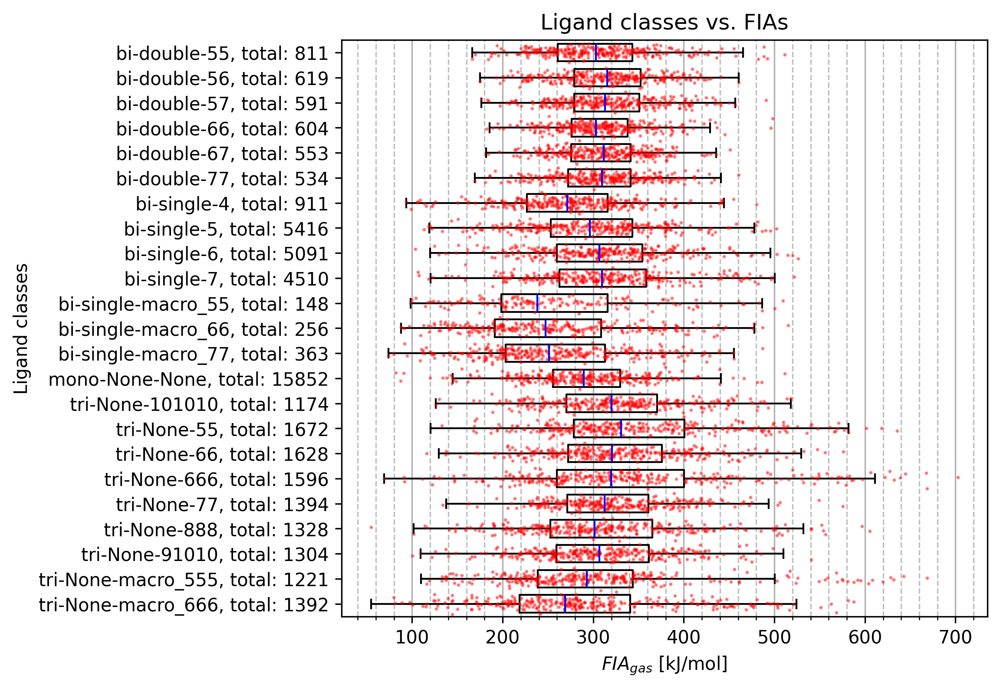

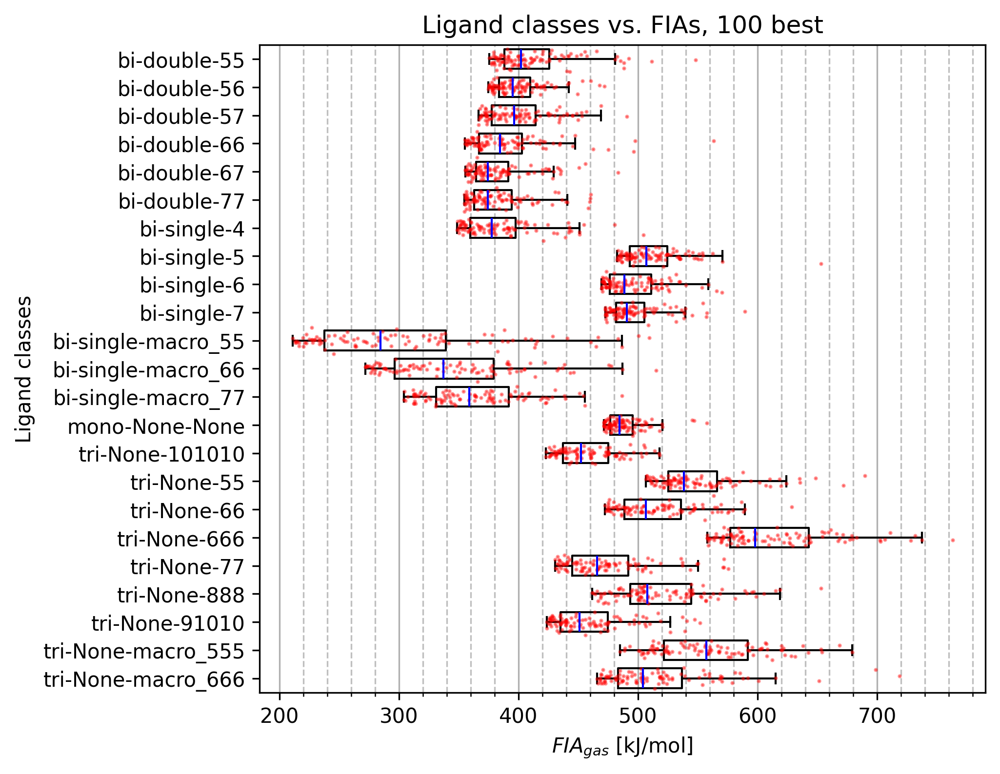

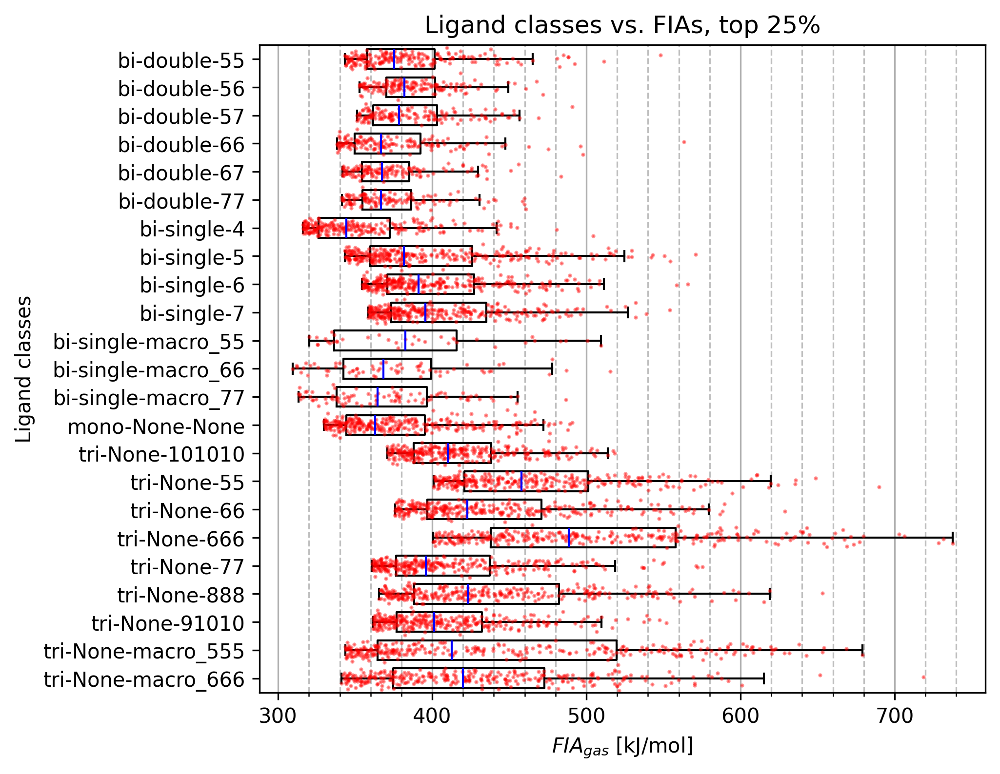

In [22]:
# basic information about molecules

with open('FIA49k.csv', newline='') as file:
    reader = csv.DictReader(file)
    info = get_info_by("ligand_info", reader)

# combine all FIAs and sort
ligand_atom_count_fia = []
for li in info.values():
    ligand_atom_count_fia += li
ligand_atom_count_fia.sort(key = itemgetter(1), reverse = True)


def parse_abtcai(string):
    _log.debug(f"Parsing string {string}...")
    return ((i[0], i[1]) for i in [i.split("-") for i in string.split("_")])


#for i, tup in enumerate(ligand_atom_count_fia[:2]):
#    print(f"{i}.", end = " ")
#    parsed = parse_abtcai(tup[4])
#    for pa in parsed:
#        print(f"{pa[0]}: {pa[1]},", end = " ")
#    print(f"Compound: {tup[0]}")
#    print(f"FIA: {tup[1]}")
#    mol = Chem.MolFromSmiles(tup[2])
#    query_properties(mol, tup[4], tup[3])
#    opts = Draw.rdMolDraw2D.MolDrawOptions()
#    opts.addAtomIndices = True
#    display(Draw.MolToImage(mol, options = opts))
#    print("-----------------------------------------------------")

with open('FIA49k.csv', newline='') as file:
    reader = csv.DictReader(file)
    info = get_info_by("ligand_info", reader, fetch_fia_only = True)
    # drop classes with less than BEST occurrences
    info = {k: v for k, v in info.items() if not len(v) < BEST}
draw_boxplots(info.values(), [f"{k}, total: {len(v)}" for k, v in info.items()], fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]", "Ligand classes", "Ligand classes vs. FIAs", save_as = "classes")

info_best = deepcopy(info)
info_top = deepcopy(info)

for k, v in info_best.items():
    info_best[k] = v[:BEST]
draw_boxplots(info_best.values(), info_best.keys(), fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]", "Ligand classes", f"Ligand classes vs. FIAs, {BEST} best", save_as = "classes_best")

for k, v in info_top.items():
    info_top[k] = v[:int(len(v) * TOP)]
draw_boxplots(info_top.values(), info_top.keys(), fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]", "Ligand classes", f"Ligand classes vs. FIAs, top {int(TOP * 100)}%", save_as = "classes_top")

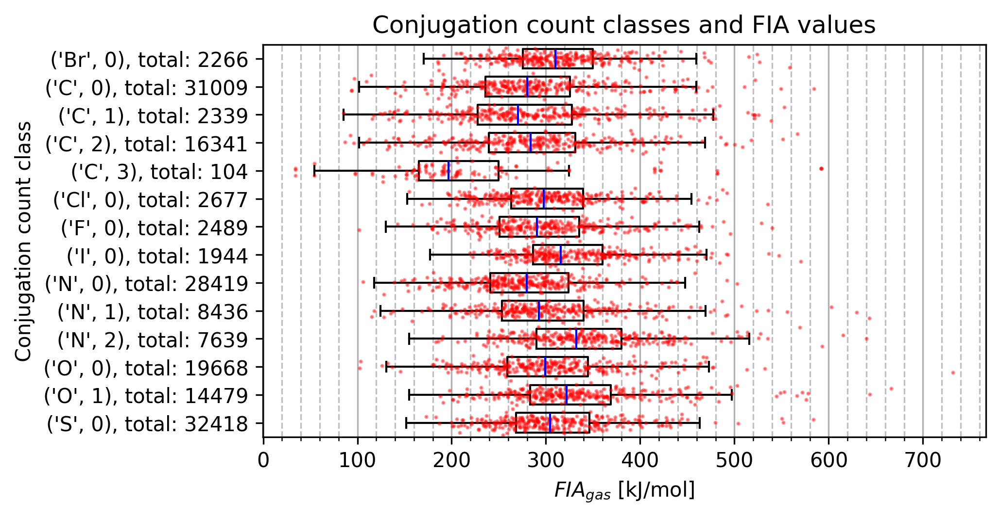

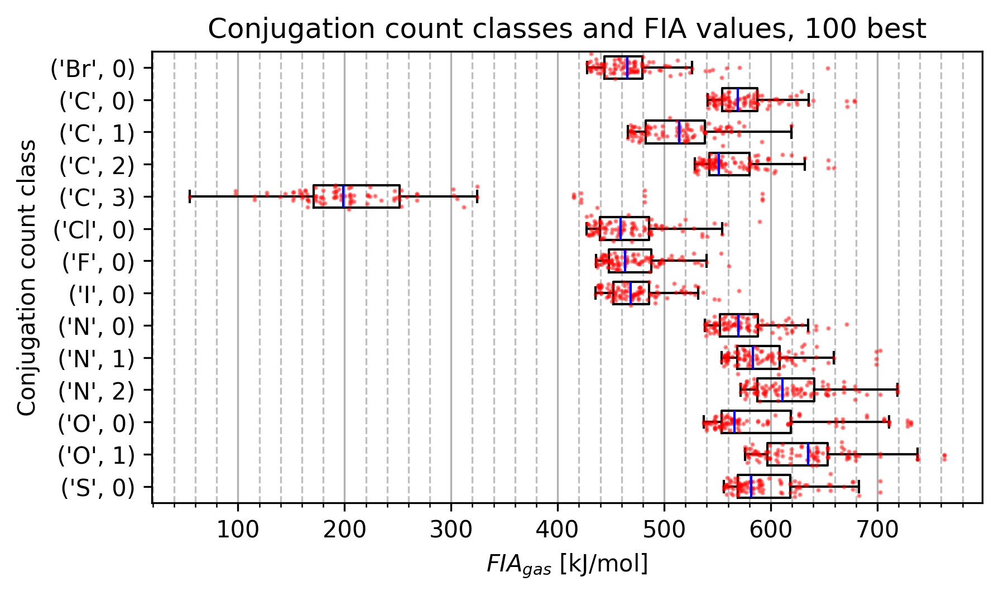

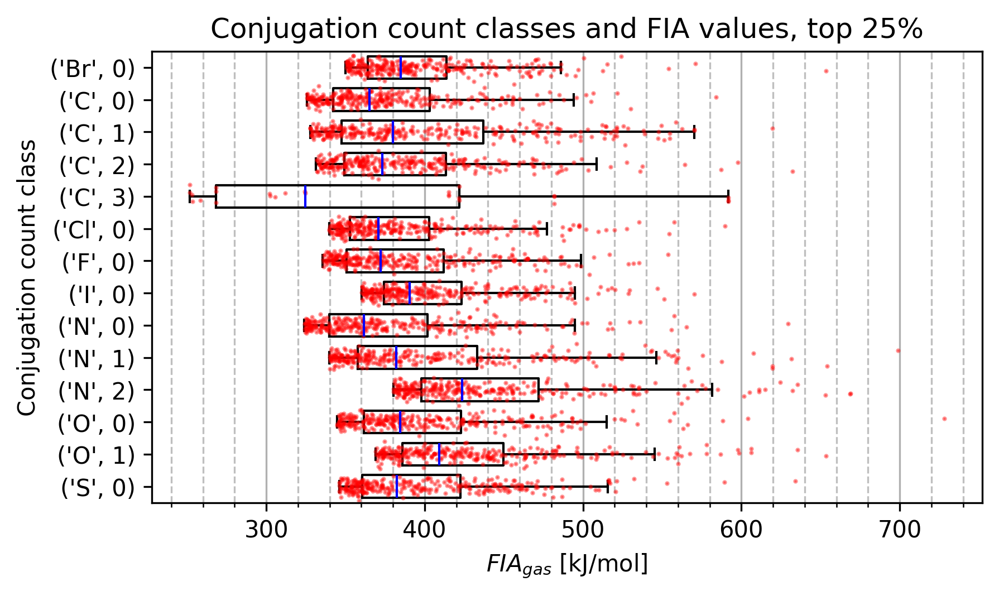

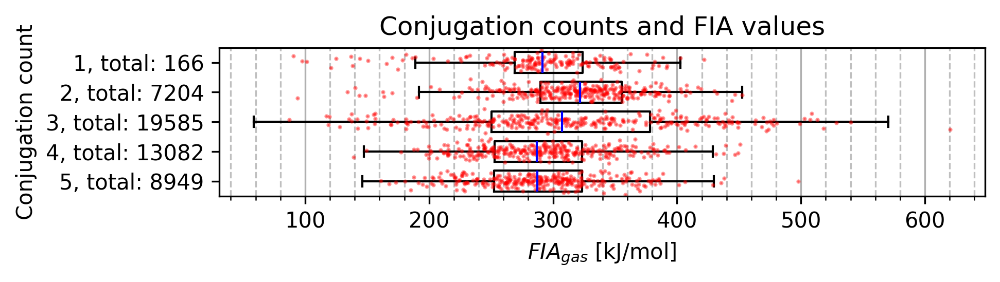

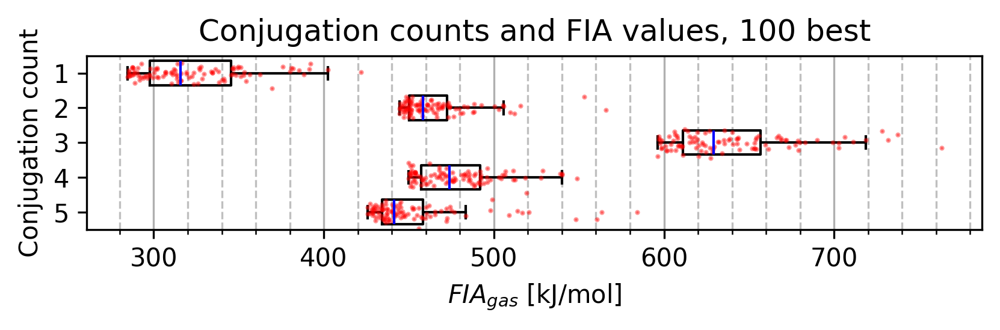

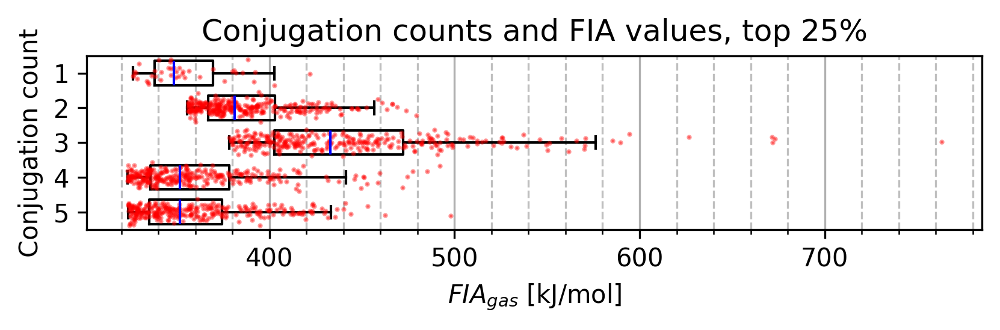

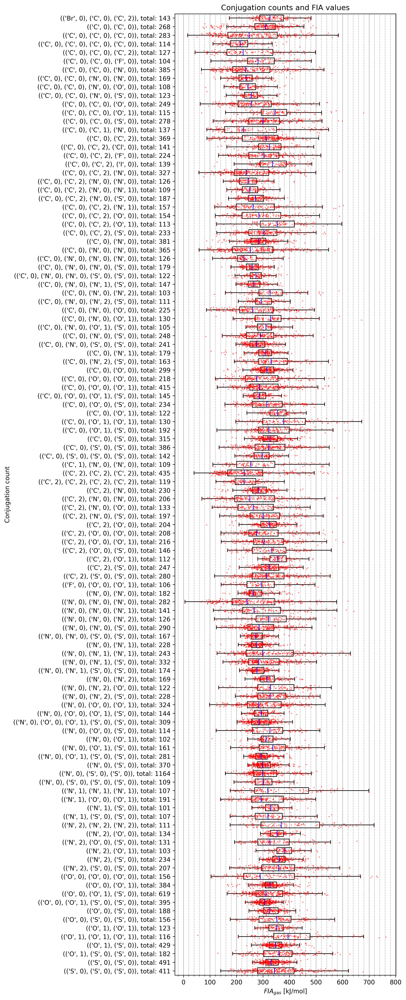

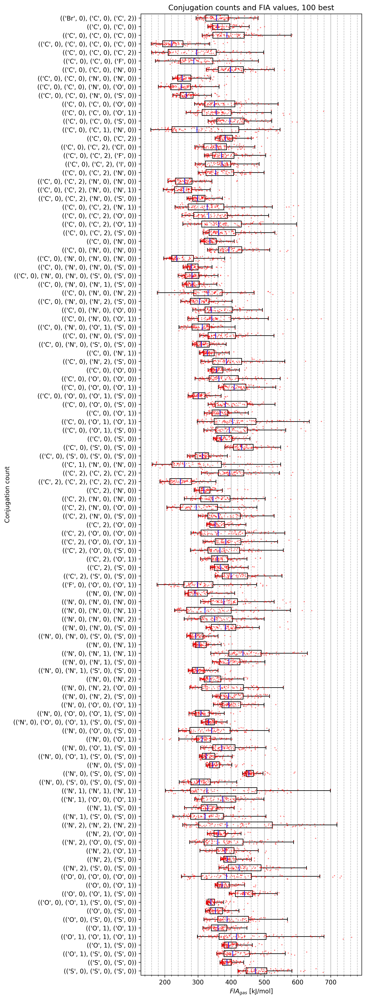

In [23]:
# conjugation count experiments

with open('FIA49k.csv', newline='') as file:
    reader = csv.DictReader(file)
    info = get_info_by(
        "conjugation_count",
        reader,
        fetch_fia_only = True,
        conjugation_count_single_classes = True
    )
    # drop classes with less than BEST occurrences
    info = {k: v for k, v in info.items() if not len(v) < BEST}

info_best = deepcopy(info)
info_top = deepcopy(info)
for k, v in info_best.items():
    info_best[k] = v[:BEST]
for k, v in info_top.items():
    info_top[k] = v[:int(len(v) * TOP)]
    
draw_boxplots(
    info.values(),
    [f"{k}, total: {len(v)}" for k, v in info.items()],
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Conjugation count class",
    "Conjugation count classes and FIA values",
    save_as = "conjugation_class"
)

draw_boxplots(
    info_best.values(),
    info_best.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Conjugation count class",
    f"Conjugation count classes and FIA values, {BEST} best",
    save_as = "conjugation_class_best"
)

draw_boxplots(
    info_top.values(),
    info_top.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Conjugation count class",
    f"Conjugation count classes and FIA values, top {int(TOP * 100)}%",
    save_as = "conjugation_class_top"
)

with open('FIA49k.csv', newline='') as file:
    reader = csv.DictReader(file)
    info = get_info_by(
        "conjugation_count",
        reader,
        fetch_fia_only = True,
        conjugation_count_summarize = True
    )
    # drop classes with less than BEST occurrences
    info = {k: v for k, v in info.items() if not len(v) < BEST}

draw_boxplots(
    info.values(),
    [f"{k}, total: {len(v)}" for k, v in info.items()],
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Conjugation count",
    "Conjugation counts and FIA values",
    save_as = "conjugation"
)

info_best = deepcopy(info)
info_top = deepcopy(info)
for k, v in info_best.items():
    info_best[k] = v[:BEST]
for k, v in info_top.items():
    info_top[k] = v[:int(len(v) * TOP)]
    
draw_boxplots(
    info_best.values(),
    info_best.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Conjugation count",
    f"Conjugation counts and FIA values, {BEST} best",
    save_as = "conjugation_best"
)

draw_boxplots(
    info_top.values(),
    info_top.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Conjugation count",
    f"Conjugation counts and FIA values, top {int(TOP * 100)}%",
    save_as = "conjugation_top"
)

with open('FIA49k.csv', newline='') as file:
    reader = csv.DictReader(file)
    info = get_info_by(
        "conjugation_count",
        reader,
        fetch_fia_only = True,
    )
    # drop classes with less than BEST occurrences
    info = {k: v for k, v in info.items() if not len(v) < BEST}
    
draw_boxplots(
    info.values(),
    [f"{k}, total: {len(v)}" for k, v in info.items()],
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Conjugation count",
    "Conjugation counts and FIA values",
    save_as = "conjugation_class_detail"
)

for k, v in info.items():
    info[k] = v[:BEST]

draw_boxplots(
    info.values(),
    info.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Conjugation count",
    f"Conjugation counts and FIA values, {BEST} best",
    save_as = "conjugation_class_detail_best"
)

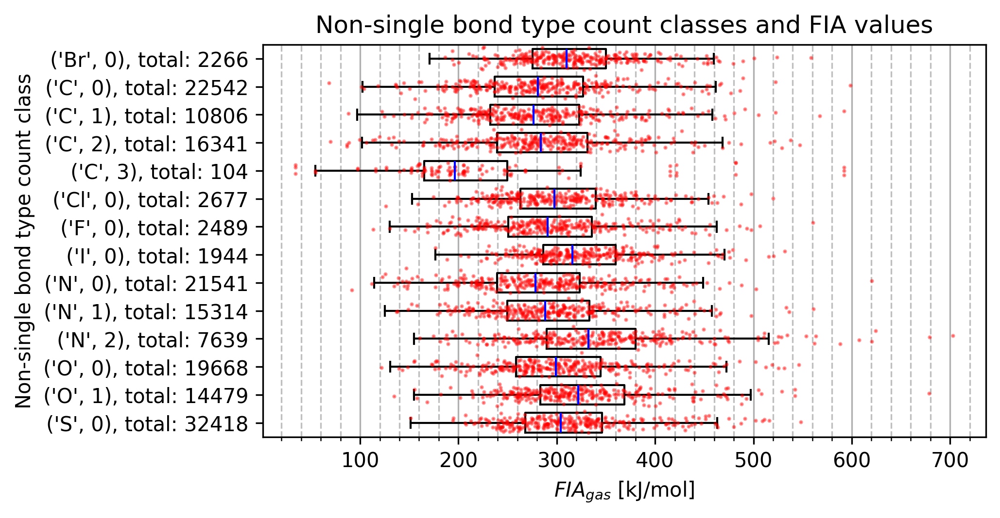

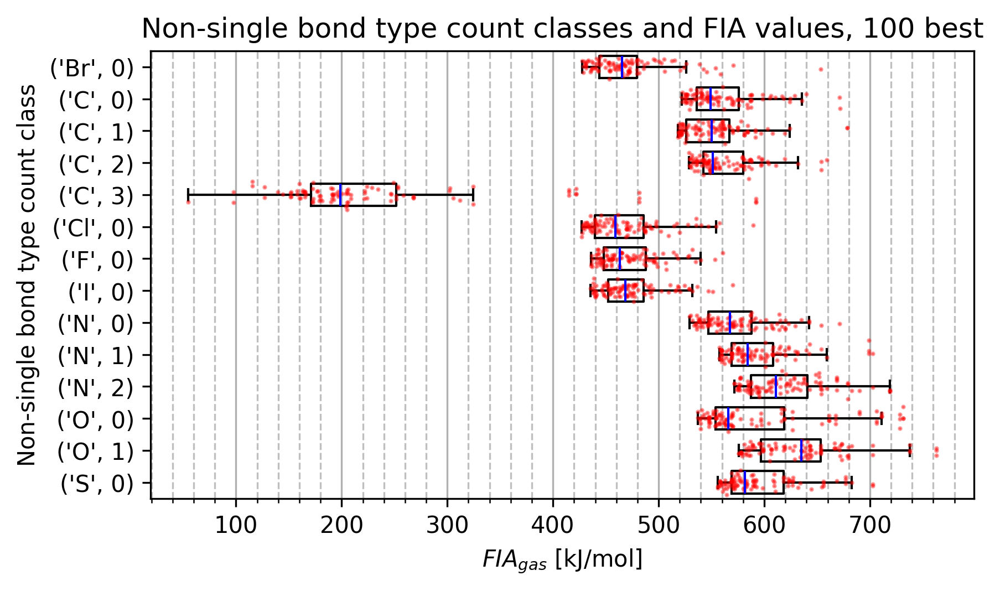

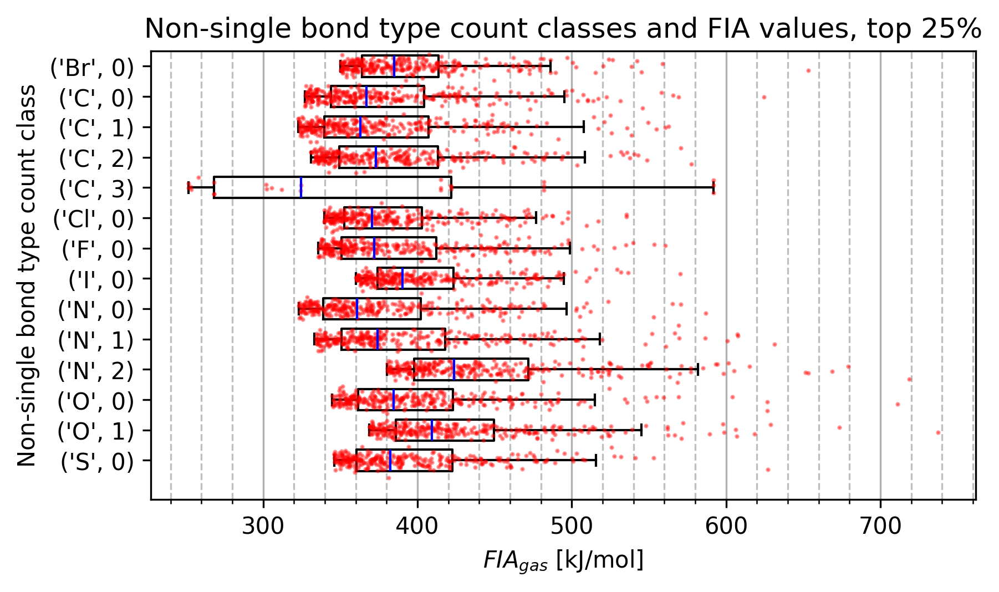

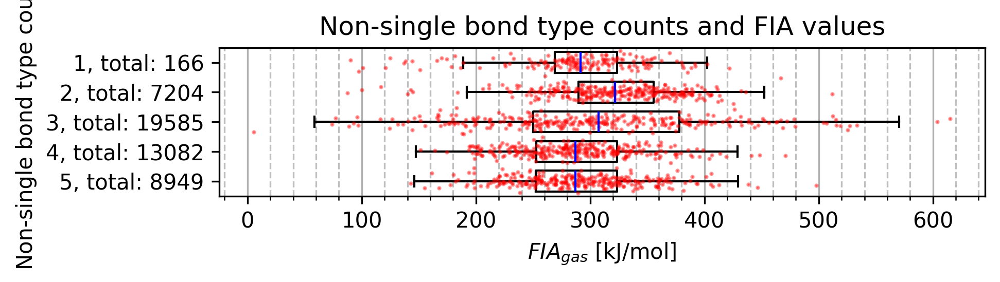

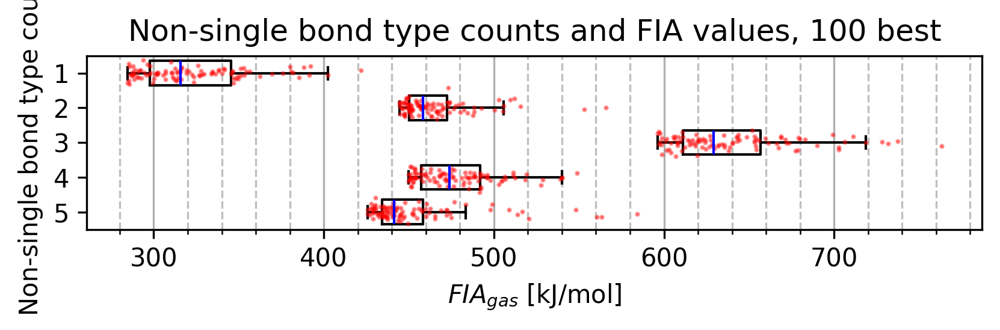

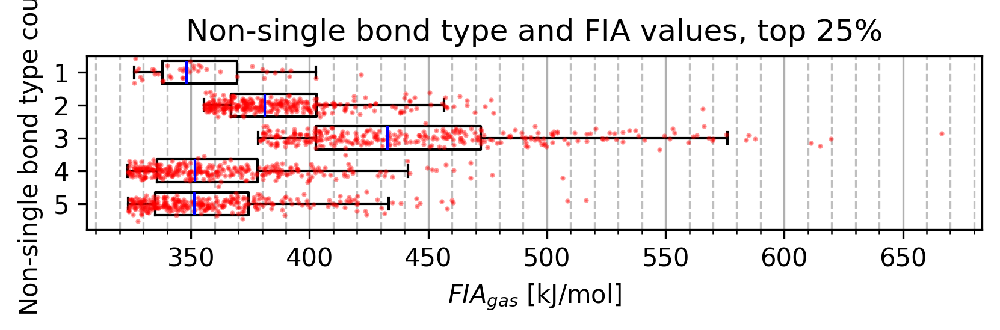

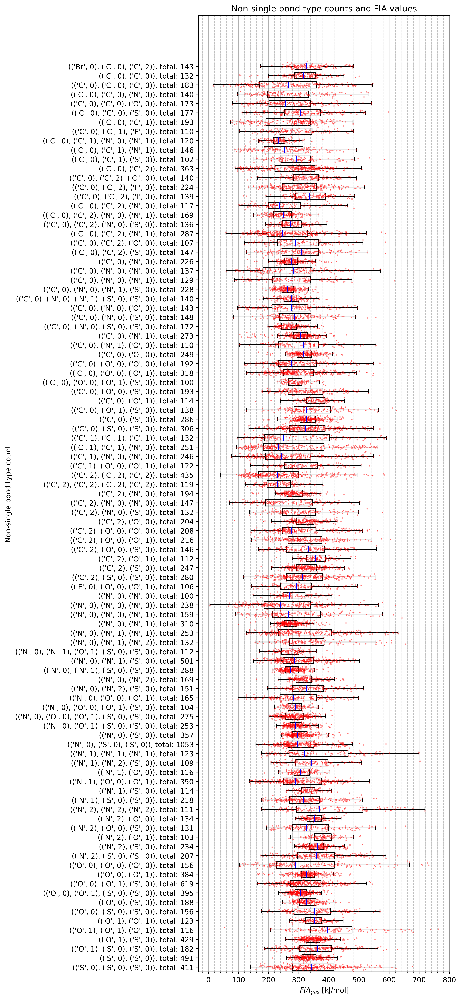

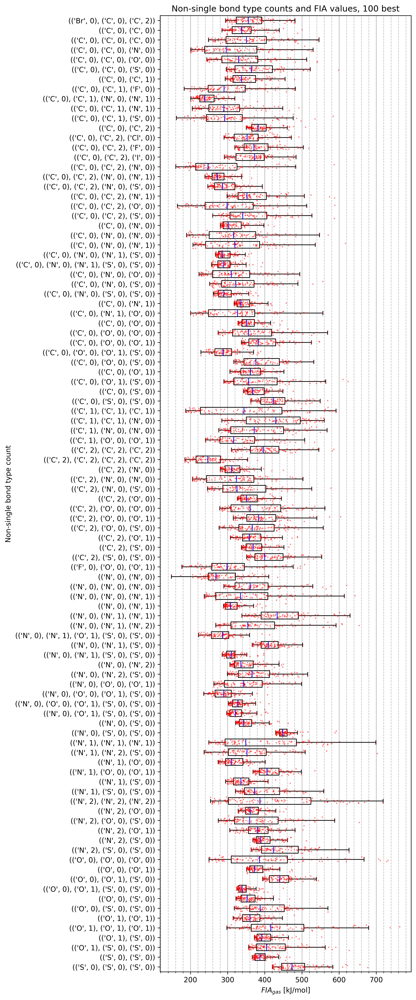

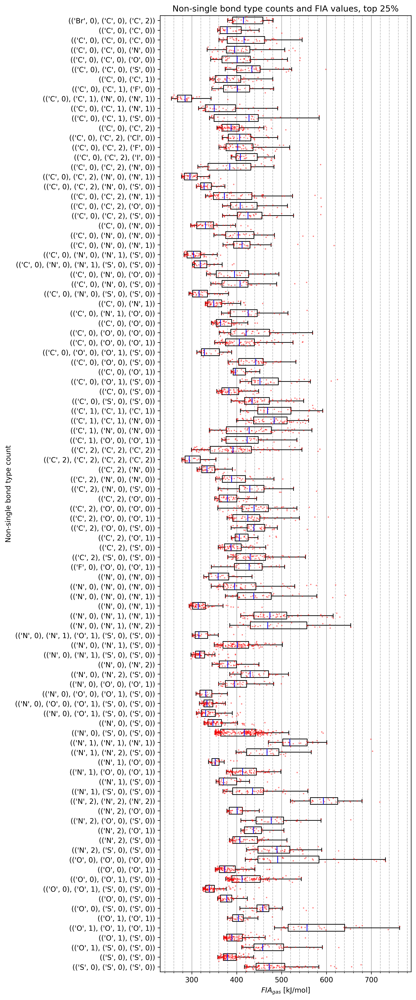

In [24]:
# non single bond type count experiments

with open('FIA49k.csv', newline='') as file:
    reader = csv.DictReader(file)
    info = get_info_by(
        "non_single_count",
        reader,
        fetch_fia_only = True,
        non_single_count_single_classes = True
    )
    # drop classes with less than BEST occurrences
    info = {k: v for k, v in info.items() if not len(v) < BEST}

info_best = deepcopy(info)
info_top = deepcopy(info)
for k, v in info_best.items():
    info_best[k] = v[:BEST]
for k, v in info_top.items():
    info_top[k] = v[:int(len(v) * TOP)]
    
draw_boxplots(
    info.values(),
    [f"{k}, total: {len(v)}" for k, v in info.items()],
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Non-single bond type count class",
    "Non-single bond type count classes and FIA values",
    save_as = "non_single_class"
)

draw_boxplots(
    info_best.values(),
    info_best.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Non-single bond type count class",
    f"Non-single bond type count classes and FIA values, {BEST} best",
    save_as = "non_single_class_best"
)

draw_boxplots(
    info_top.values(),
    info_top.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Non-single bond type count class",
    f"Non-single bond type count classes and FIA values, top {int(TOP * 100)}%",
    save_as = "non_single_class_top"
)

with open('FIA49k.csv', newline='') as file:
    reader = csv.DictReader(file)
    info = get_info_by(
        "non_single_count",
        reader,
        fetch_fia_only = True,
        non_single_count_summarize = True
    )
    # drop classes with less than BEST occurrences
    info = {k: v for k, v in info.items() if not len(v) < BEST}

draw_boxplots(
    info.values(),
    [f"{k}, total: {len(v)}" for k, v in info.items()],
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Non-single bond type count",
    "Non-single bond type counts and FIA values",
    save_as = "non_single"
)

info_best = deepcopy(info)
info_top = deepcopy(info)
for k, v in info_best.items():
    info_best[k] = v[:BEST]
for k, v in info_top.items():
    info_top[k] = v[:int(len(v) * TOP)]
    
draw_boxplots(
    info_best.values(),
    info_best.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Non-single bond type count",
    f"Non-single bond type counts and FIA values, {BEST} best",
    save_as = "non_single_best"
)

draw_boxplots(
    info_top.values(),
    info_top.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Non-single bond type count",
    f"Non-single bond type and FIA values, top {int(TOP * 100)}%",
    save_as = "non_single_top"
)

with open('FIA49k.csv', newline='') as file:
    reader = csv.DictReader(file)
    info = get_info_by(
        "non_single_count",
        reader,
        fetch_fia_only = True,
    )
    # drop classes with less than BEST occurrences
    info = {k: v for k, v in info.items() if not len(v) < BEST}
    
info_best = deepcopy(info)
info_top = deepcopy(info)
for k, v in info_best.items():
    info_best[k] = v[:BEST]
for k, v in info_top.items():
    info_top[k] = v[:int(len(v) * TOP)]
    
draw_boxplots(
    info.values(),
    [f"{k}, total: {len(v)}" for k, v in info.items()],
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Non-single bond type count",
    "Non-single bond type counts and FIA values",
    save_as = "non_single_class_detail"
)

draw_boxplots(
    info_best.values(),
    info_best.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Non-single bond type count",
    f"Non-single bond type counts and FIA values, {BEST} best",
    save_as = "non_single_class_detail_best"
)

draw_boxplots(
    info_top.values(),
    info_top.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Non-single bond type count",
    f"Non-single bond type counts and FIA values, top {int(TOP * 100)}%",
    save_as = "non_single_class_detail_top"
)

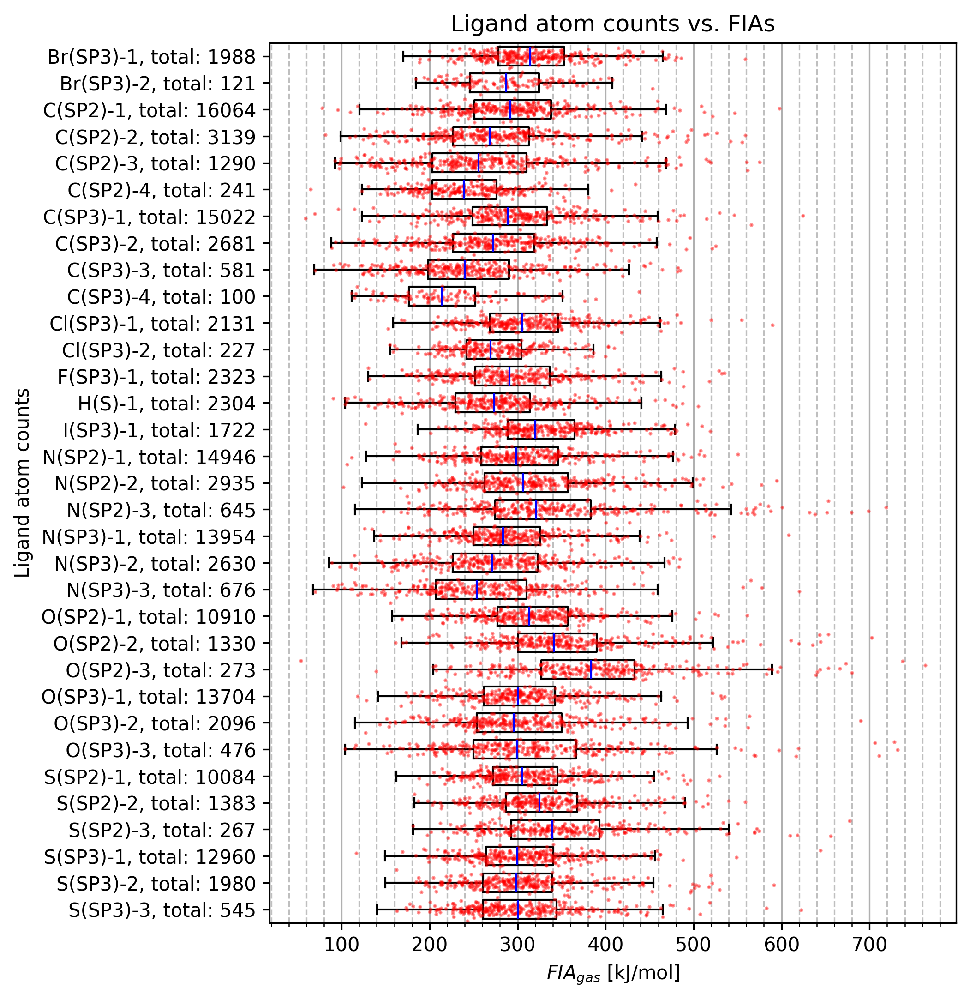

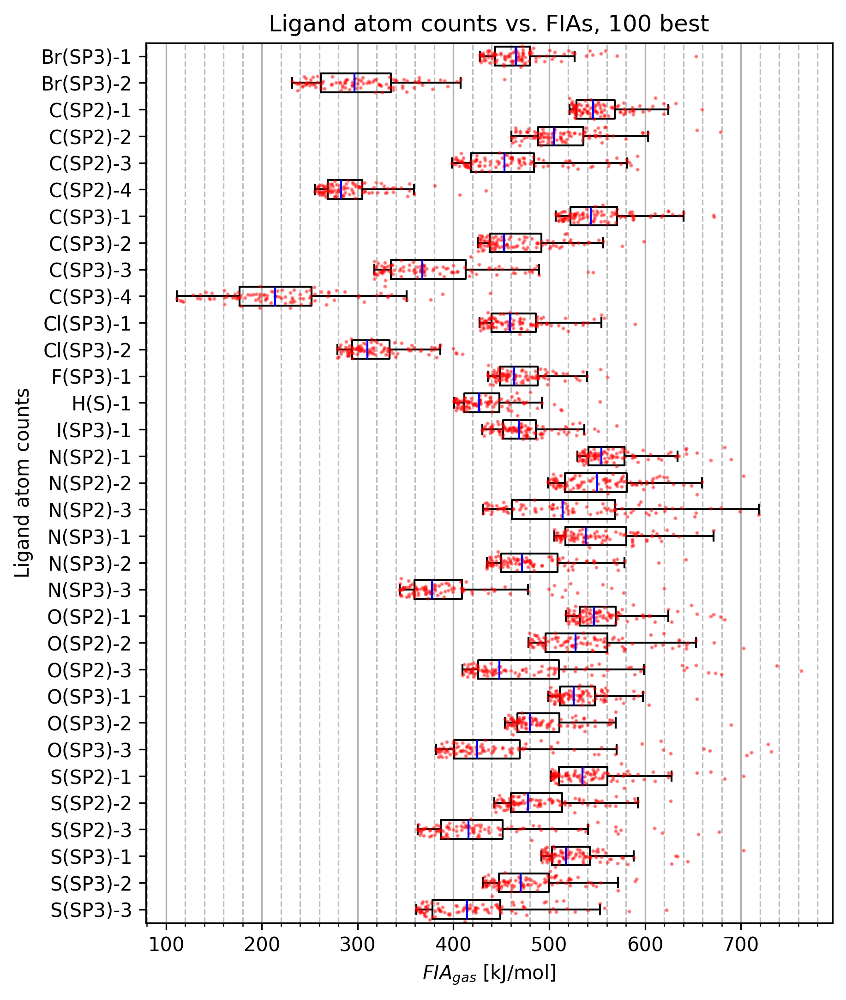

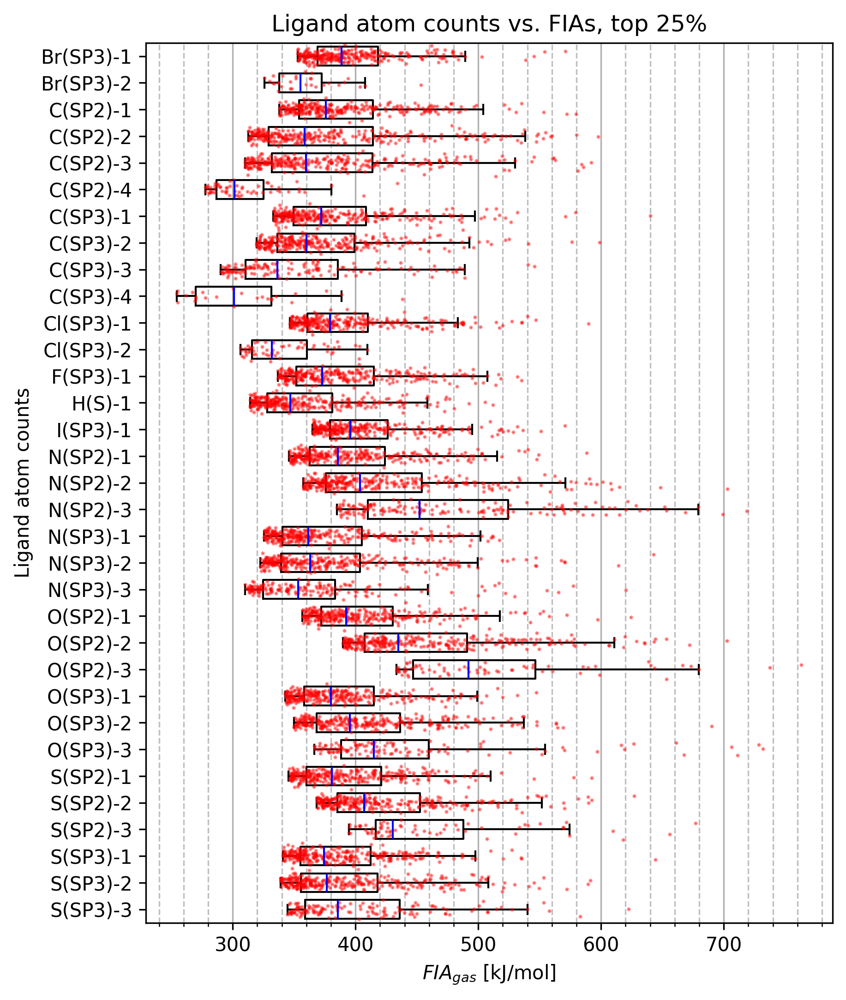

In [25]:
# investigation of sp2 and sp3

with open('FIA49k.csv', newline='') as file:
    reader = csv.DictReader(file)
    info = get_info_by("ligand_atom_types", reader, sort = True)

#for i in [1, 2, 3]:
#    print(f"First three molecules of N(SP3)-{i}:")
#    for tup in info[f"N(SP3)-{i}"][:3]:
#        print(f"{tup[0]}, ligand atoms {tup[4]}")
#        print(f"SMILES: {tup[2]}")
#        mol = Chem.MolFromSmiles(tup[2])
#        query_properties(mol, tup[4], tup[3])
#        opts = Draw.rdMolDraw2D.MolDrawOptions()
#        opts.addAtomIndices = True
#        display(Draw.MolToImage(mol, options = opts))
#        print("--------------")
#    
#for i in [1, 2, 3]:
#    print(f"First three molecules of N(SP2)-{i}:")
#    for tup in info[f"N(SP2)-{i}"][:3]:
#        print(f"{tup[0]}, ligand atoms {tup[4]}")
#        print(f"SMILES: {tup[2]}")
#        mol = Chem.MolFromSmiles(tup[2])
#        query_properties(mol, tup[4], tup[3])
#        opts = Draw.rdMolDraw2D.MolDrawOptions()
#        opts.addAtomIndices = True
#        display(Draw.MolToImage(mol, options = opts))
#        print("--------------")
        
# remove all info other than FIA, change in-place
for li in info.values():
    for i, l in enumerate(li):
        li[i] = l[1]
# drop all ligand atoms with less than BEST occurrences
info = {k: v for k, v in info.items() if not len(v) < BEST}

draw_boxplots(
    info.values(),
    [f"{k}, total: {len(v)}" for k, v in info.items()],
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Ligand atom counts",
    "Ligand atom counts vs. FIAs",
    save_as = "ligand_hybrid_counts.png",
)

info_best = deepcopy(info)
info_top = deepcopy(info)
for k, v in info_best.items():
    info_best[k] = v[:BEST]
for k, v in info_top.items():
    info_top[k] = v[:int(len(v) * TOP)]

draw_boxplots(
    info_best.values(),
    info_best.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Ligand atom counts",
    f"Ligand atom counts vs. FIAs, {BEST} best",
    save_as = "ligand_hybrid_counts_best.png",
)

draw_boxplots(
    info_top.values(),
    info_top.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Ligand atom counts",
    f"Ligand atom counts vs. FIAs, top {int(TOP * 100)}%",
    save_as = "ligand_hybrid_counts_top.png",
)


#for k, v in info.items():
#    info[k] = v[:int(len(v) * .25)]
#    
#draw_boxplots(
#    info.values(),
#    info.keys(),
#    "FIA solvation values",
#    "Ligand atom counts",
#    "Ligand atom counts and all corresponding FIA values, top 25%",
#    save_as = "25.png",
#    size = 10,
#)
#
#for k, v in info.items():
#    info[k] = v[:int(len(v) * .2)]
#    
#draw_boxplots(
#    info.values(),
#    info.keys(),
#    "FIA solvation values",
#    "Ligand atom counts",
#    "Ligand atom counts and all corresponding FIA values, top 5%",
#    save_as = "5.png",
#    size = 10,
#)

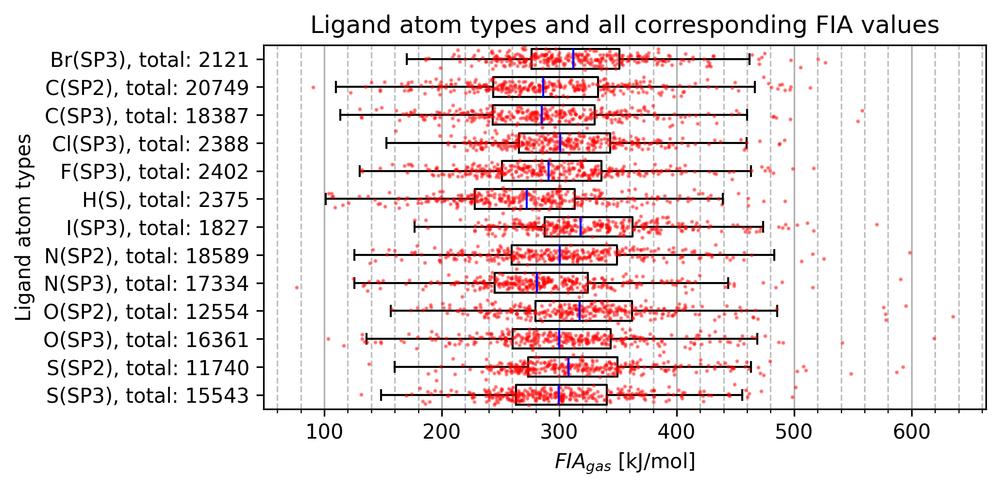

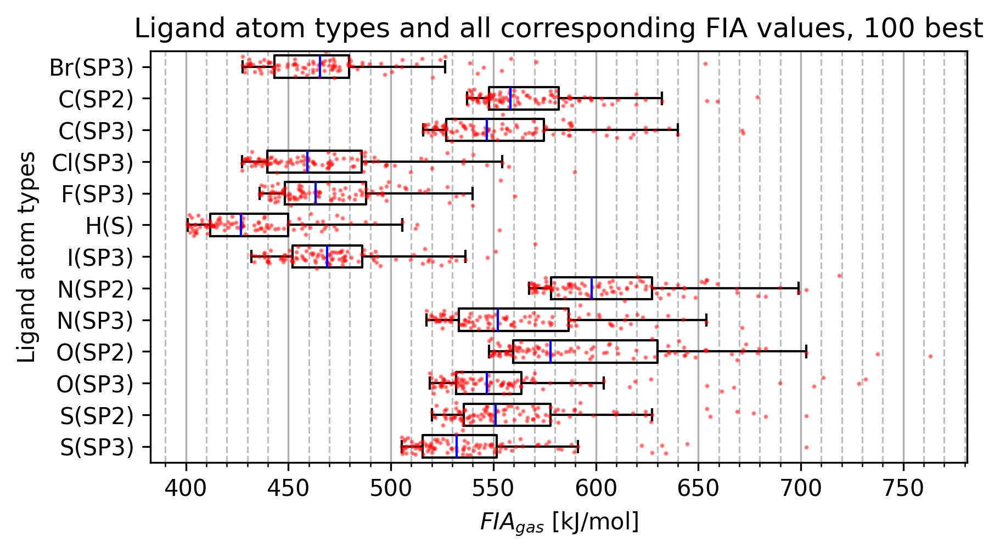

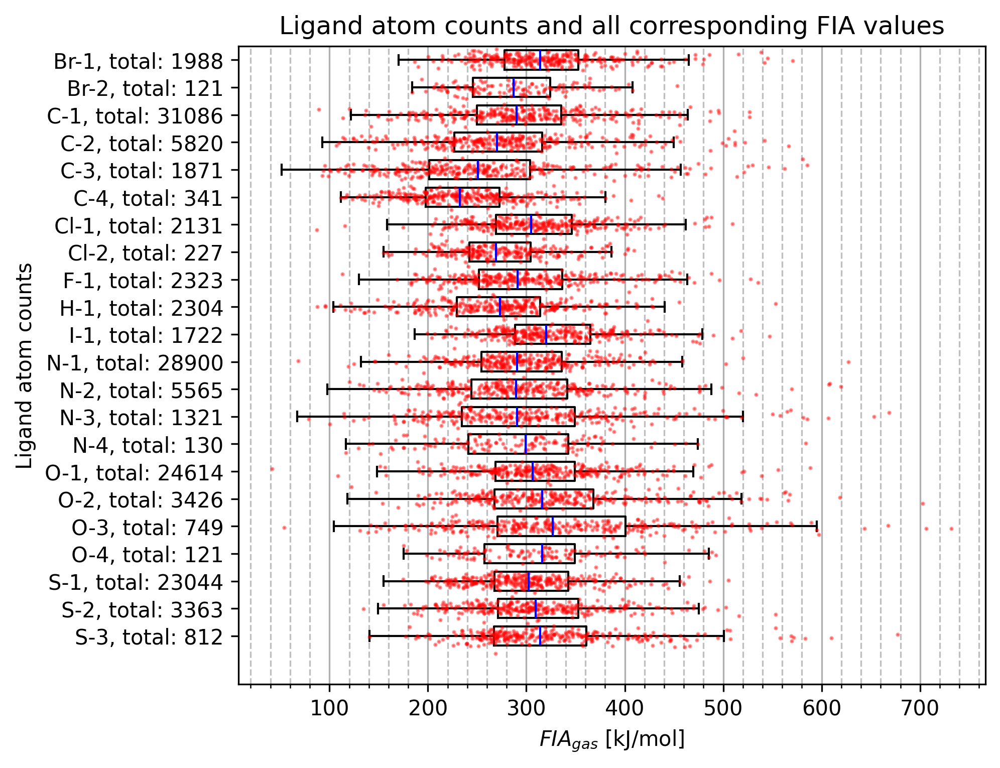

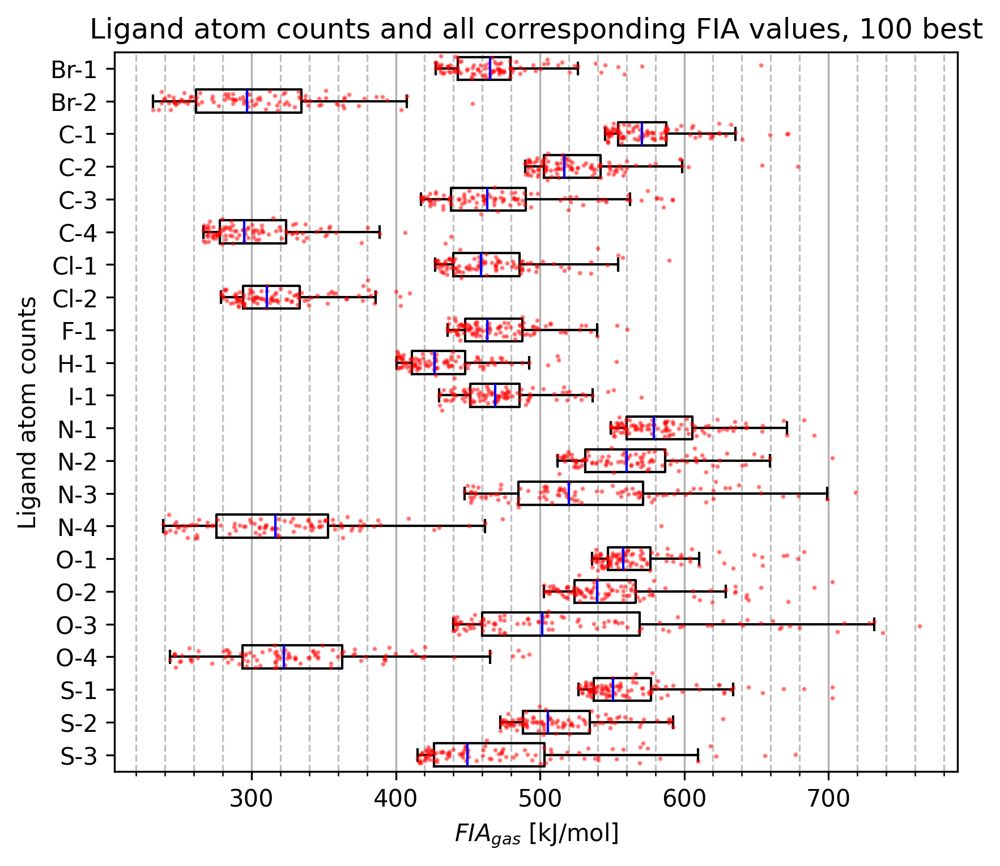

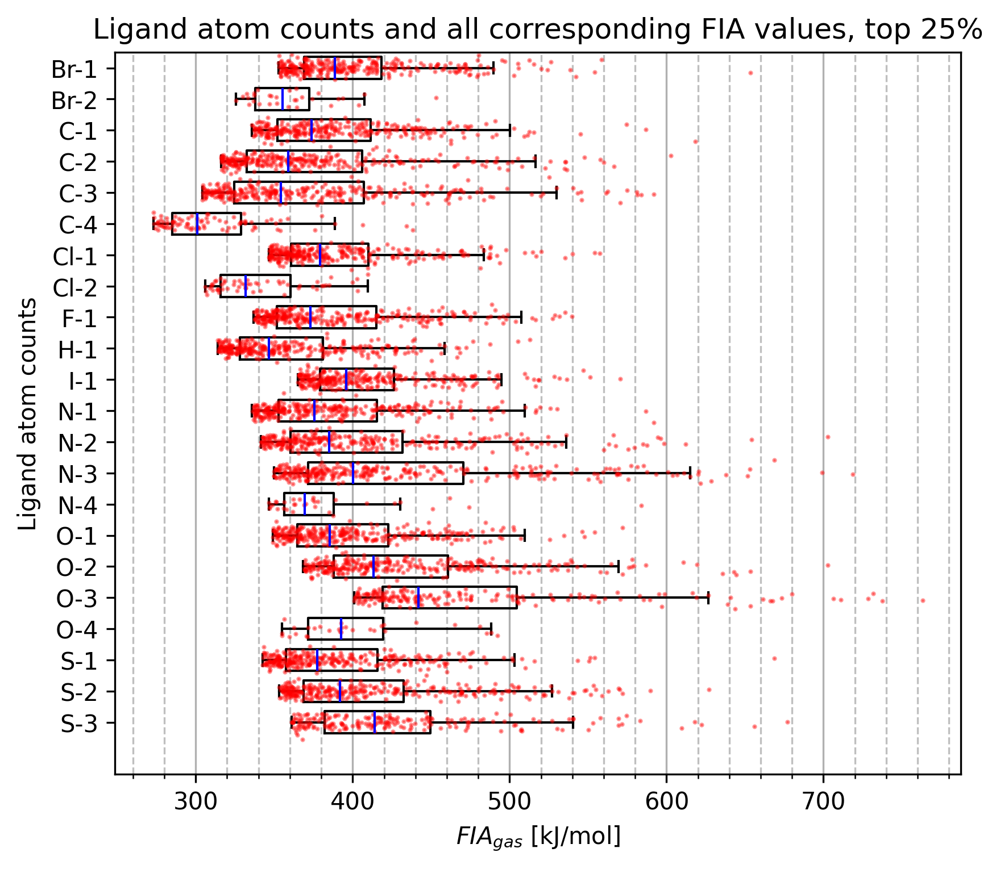

In [26]:
## group ligand counts together, only sp2 and sp3 as total
#
#with open('FIA49k.csv', newline='') as file:
#    reader = csv.DictReader(file)
#    info = get_info_by(
#        "ligand_atom_types",
#        reader,
#        ligand_atom_counts_group = True,
#        fetch_fia_only = True,
#    )
#
#draw_boxplots(
#    info.values(),
#    info.keys(),
#    "FIA solvation values",
#    "Ligand atom types",
#    "Ligand atom types and all corresponding FIA values",
#    size = 10,
#)
#
#for k, v in info.items():
#    info[k] = v[:int(len(v) * .25)]
#    
#draw_boxplots(
#    info.values(),
#    info.keys(),
#    "FIA solvation values",
#    "Ligand atom types",
#    "Ligand atom types and all corresponding FIA values, top 25%",
#    size = 10,
#)
#
#for k, v in info.items():
#    info[k] = v[:int(len(v) * .2)]
#    
#draw_boxplots(
#    info.values(),
#    info.keys(),
#    "FIA solvation values",
#    "Ligand atom types",
#    "Ligand atom types and all corresponding FIA values, top 5%",
#    size = 10,
#    save_as = "5_types.png"
#)
#with open('FIA49k.csv', newline='') as file:
#    reader = csv.DictReader(file)
#    info = get_info_by(
#        "ligand_atom_counts",
#        reader,
#        ligand_atom_counts_group = True,
#        fetch_fia_only = True,
#    )
#
#draw_boxplots(
#    info.values(),
#    info.keys(),
#    "FIA solvation values",
#    "Ligand atom counts",
#    "Ligand atom counts and all corresponding FIA values",
#    size = 10,
#)
#
#for k, v in info.items():
#    info[k] = v[:int(len(v) * .05)]
#    
#draw_boxplots(
#    info.values(),
#    info.keys(),
#    "FIA solvation values",
#    "Ligand atom counts",
#    "Ligand atom counts and all corresponding FIA values, top 5%",
#    size = 10,
#    save_as = "5_counts.png"
#)
# group ligand counts together, only sp2 and sp3 as total

with open('FIA49k.csv', newline='') as file:
    reader = csv.DictReader(file)
    info = get_info_by(
        "ligand_atom_types",
        reader,
        ligand_atom_counts_group = True,
        fetch_fia_only = True,
    )
# drop classes with less than BEST occurrences
info = {k: v for k, v in info.items() if not len(v) < BEST}

draw_boxplots(
    info.values(),
    [f"{k}, total: {len(v)}" for k, v in info.items()],
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Ligand atom types",
    "Ligand atom types and all corresponding FIA values",
    save_as = "ligand_hybrid",
)

for k, v in info.items():
    info[k] = v[:BEST]
    
draw_boxplots(
    info.values(),
    info.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Ligand atom types",
    f"Ligand atom types and all corresponding FIA values, {BEST} best",
    save_as = "ligand_hybrid_best",
)

with open('FIA49k.csv', newline='') as file:
    reader = csv.DictReader(file)
    info = get_info_by(
        "ligand_atom_counts",
        reader,
        ligand_atom_counts_group = True,
        fetch_fia_only = True,
    )
# drop classes with less than BEST occurrences
info = {k: v for k, v in info.items() if not len(v) < BEST}
info_best = deepcopy(info)
info_top = deepcopy(info)
for k, v in info_best.items():
    info_best[k] = v[:BEST]
for k, v in info_top.items():
    info_top[k] = v[:int(len(v) * TOP)]

draw_boxplots(
    info.values(),
    [f"{k}, total: {len(v)}" for k, v in info.items()],
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Ligand atom counts",
    "Ligand atom counts and all corresponding FIA values",
    save_as = "ligand_atom_counts",
)
    
draw_boxplots(
    info_best.values(),
    info_best.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Ligand atom counts",
    f"Ligand atom counts and all corresponding FIA values, {BEST} best",
    save_as = "ligand_atom_counts_best",
)

draw_boxplots(
    info_top.values(),
    info_top.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Ligand atom counts",
    f"Ligand atom counts and all corresponding FIA values, top {int(TOP * 100)}%",
    save_as = "ligand_atom_counts_top",
)

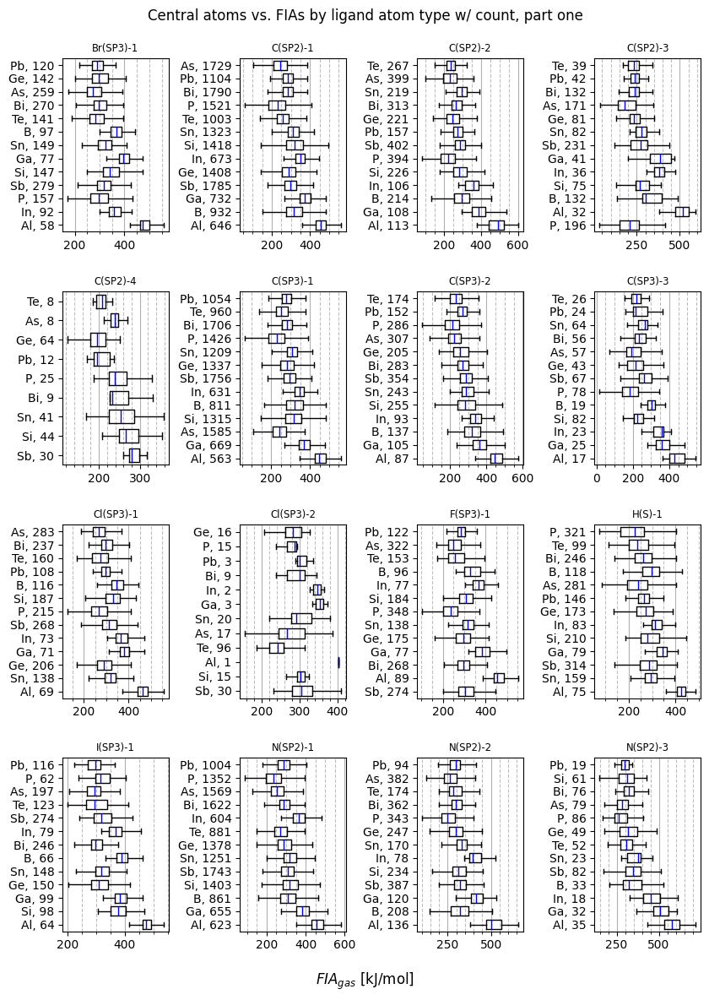

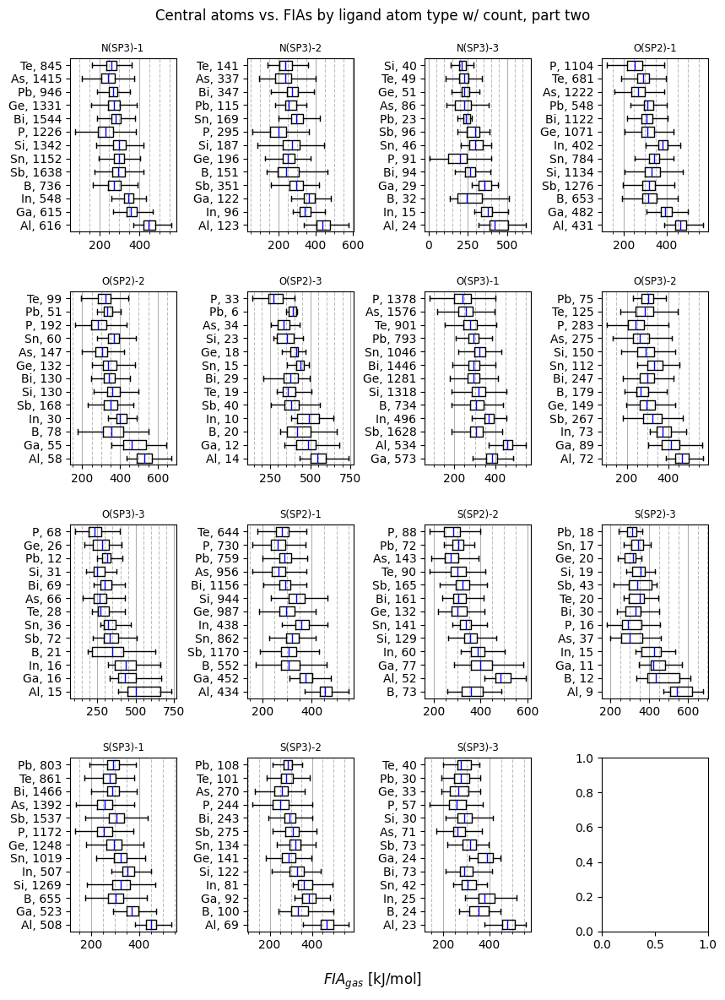

In [69]:
#with open('FIA49k.csv', newline='') as file:
#    reader = csv.DictReader(file)
#    info = get_info_by("ligand_atom_counts", reader, sort = True)
#    
#columns = 4
#fig, axs = plt.subplots(14, columns, figsize = (5,7))
#fig.set_figheight(40)
#fig.set_figwidth(8)
#fig.tight_layout(rect = [0.02, 0.015, 1, 0.97])
#i = j = 0
#for k, v in info.items():
#    by_central_atom_and_fias = {}
#    for entry in v:
#        central_atom = entry[3]
#        if by_central_atom_and_fias.get(central_atom, None) is None:
#            by_central_atom_and_fias[central_atom] = []
#        by_central_atom_and_fias[central_atom].append(entry[1])
#    axs[i][j].tick_params(labelsize = "small")
#    axs[i][j].boxplot(by_central_atom_and_fias.values(), vert = False, labels = by_central_atom_and_fias.keys())
#    axs[i][j].grid()
#    axs[i][j].set_title(f"{k}", fontsize = "small")
#    j += 1
#    if j >= columns:
#        j = 0
#        i += 1
#fig.suptitle("Central atoms and all corresponding FIA values by ligand atom count", fontsize = "large")
#fig.supxlabel("FIA solvation values")
#fig.supylabel("Central atoms")
#plt.savefig("zentral.png")
#plt.show()
with open('FIA49k.csv', newline='') as file:
    reader = csv.DictReader(file)
    info = dict(reversed(get_info_by("ligand_atom_counts", reader, sort = True).items()))
# discard all counts with less than BEST occurrences
# TODO
#info = {k: v for k, v in info.items() if v}
# after rows rows, figure will be split
rows = 4
columns = 4
info_recast = [(k, v) for k, v in info.items()]
fig, axs = plt.subplots(rows, columns, figsize = (5,7))
fig.set_figheight(12)
fig.set_figwidth(9)
fig.tight_layout(rect = [0.02, 0.015, 1, 0.97], pad = 3.0)
i = j = 0
curr_start = 0
for (k, v), num in zip(info_recast[curr_start:], range(1, len(info.values()) + 1)):
    if i >= rows:
        break
    curr_start += 1
    by_central_atom_and_fias = {}
    medianprops = dict(linestyle='-', color='blue')
    if len(v) < BEST * 2:
        continue
    for entry in v:
        central_atom = entry[3]
        if by_central_atom_and_fias.get(central_atom, None) is None:
            by_central_atom_and_fias[central_atom] = []
        by_central_atom_and_fias[central_atom].append(entry[1])
    axs[i][j].minorticks_on()
    axs[i][j].tick_params(axis = "y", which = "minor", left = False, labelsize = "small")
    axs[i][j].grid(axis = "x", which = "both")
    axs[i][j].grid(axis = "x", which = "minor", alpha = 0.8, linestyle = "--")
    axs[i][j].boxplot(
        by_central_atom_and_fias.values(),
        vert = False,
        widths = 0.7,
        medianprops = medianprops,
        showfliers = False,
        labels = [f"{k}, {len(v)}" for k, v in by_central_atom_and_fias.items()]
    )
    axs[i][j].set_title(f"{k}", fontsize = "small")
    j += 1
    if j >= columns:
        j = 0
        i += 1
fig.suptitle("Central atoms vs. FIAs by ligand atom type w/ count, part one", fontsize = "large")
fig.supxlabel(fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]")
plt.savefig("central_first.png")
plt.show()
fig, axs = plt.subplots(rows, columns, figsize = (5,7))
fig.set_figheight(12)
fig.set_figwidth(9)
fig.tight_layout(rect = [0.02, 0.015, 1, 0.97], pad = 3.0)
i = j = 0
for (k, v), num in zip(info_recast[curr_start:], range(1, len(info.values()) + 1)):
    by_central_atom_and_fias = {}
    medianprops = dict(linestyle='-', color='blue')
    if len(v) < BEST * 2:
        continue
    for entry in v:
        central_atom = entry[3]
        if by_central_atom_and_fias.get(central_atom, None) is None:
            by_central_atom_and_fias[central_atom] = []
        by_central_atom_and_fias[central_atom].append(entry[1])
    axs[i][j].minorticks_on()
    axs[i][j].tick_params(axis = "y", which = "minor", left = False, labelsize = "small")
    axs[i][j].grid(axis = "x", which = "both")
    axs[i][j].grid(axis = "x", which = "minor", alpha = 0.8, linestyle = "--")
    axs[i][j].boxplot(
        by_central_atom_and_fias.values(),
        vert = False,
        widths = 0.7,
        medianprops = medianprops,
        showfliers = False,
        labels = [f"{k}, {len(v)}" for k, v in by_central_atom_and_fias.items()]
    )
    axs[i][j].set_title(f"{k}", fontsize = "small")
    j += 1
    if j >= columns:
        j = 0
        i += 1
fig.suptitle("Central atoms vs. FIAs by ligand atom type w/ count, part two", fontsize = "large")
fig.supxlabel(fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]")
plt.savefig("central_second.png")
plt.show()

In [3]:
# basic traversal of lewis acids

curr = 0
step_size = 5

with open('FIA49k.csv', newline='') as file:
    reader = csv.DictReader(file)
    info = get_info_by("ligand_info", reader)

# combine all FIAs and sort
ligand_atom_count_fia = []
for li in info.values():
    ligand_atom_count_fia += li
ligand_atom_count_fia.sort(key = itemgetter(1), reverse = True)

def draw_current():
    with output:
        output.clear_output()
        current_element = ligand_atom_count_fia[curr]
        print(f"FIA: {current_element[1]}")
        mol = Chem.MolFromSmiles(current_element[2])
        opts = Draw.rdMolDraw2D.MolDrawOptions()
        opts.addAtomIndices = True
        display(Draw.MolToImage(mol, options = opts))

def inc_and_redraw(_):
    global curr
    curr += step_size 
    draw_current()

def dec_and_redraw(_):
    global curr
    curr -= step_size
    draw_current()
    
button_next = widgets.Button(
    description='next LA',
    disabled=False,
    button_style='', # 'success', 'info', 'warning', 'danger' or ''
    tooltip='next lewis acid',
    icon='arrow-right' # (FontAwesome names without the `fa-` prefix)
)
button_next.on_click(inc_and_redraw)
button_prev = widgets.Button(
    description='previous LA',
    disabled=False,
    button_style='', # 'success', 'info', 'warning', 'danger' or ''
    tooltip='previous lewis acid',
    icon='arrow-left' # (FontAwesome names without the `fa-` prefix)
)
button_prev.on_click(dec_and_redraw)
output = widgets.Output()
draw_current()
display(button_prev, button_next)
display(output)

Button(description='previous LA', icon='arrow-left', style=ButtonStyle(), tooltip='previous lewis acid')

Button(description='next LA', icon='arrow-right', style=ButtonStyle(), tooltip='next lewis acid')

Output()

In [18]:
from queue import SimpleQueue
from rdkit import RDLogger
RDLogger.DisableLog('rdApp.*')

# how to count symmetric multi paths?
class Channel:
    # this should only be used when counting from the central atom
    def __init__(self, mol, central_atom):
        self.chain = [central_atom.GetIdx()]
        self.mol = mol
        self.conjugated = True
        self.aromatic = True
        self.final = False
        self._metal_as_central_atom = True if central_atom.GetSymbol() in (
            "B", "Al", "Ga", "In",
            "Si", "Ge", "Sn", "Pb",
            "P", "As", "Sb", "Bi",
            "Te",
        ) else False

    def add(self, next_atom):
        if self.final:
            # do not add to finalized channel
            return
        bond = self.mol.GetBondBetweenAtoms(self.chain[-1], next_atom.GetIdx())
        if bond is None:
            raise ValueError(f"Bond not found between idx {self.chain[-1]} and {next_atom.GetIdx()}!")
        self.chain.append(next_atom.GetIdx())
        # skip checks if only central atom and next atom is present
        if len(self.chain) != 2 or not self._metal_as_central_atom:
            if not bond.GetIsConjugated():
                self.conjugated = False
            if not bond.GetIsAromatic():
                self.aromatic = False
            if next_atom.GetSymbol() not in ("C", "H"):
                # hetero atom found, finalize chain
                self.final = True
        
def get_all_channels_new(mol, ca: str):
    search_string = f"[#{Chem.MolFromSmarts(f"[{ca}]").GetAtomWithIdx(0).GetAtomicNum()}]"
    res = mol.GetSubstructMatch(Chem.MolFromSmarts(search_string))
    if not res:
        raise ValueError(f"Central atom with search string {search_string} not found!")
    ca_index = res[0]
    seen = set((ca_index,))
    central_atom = mol.GetAtomWithIdx(ca_index)
    distances = GetDistanceMatrix(mol)
    ca_neighbors = central_atom.GetNeighbors()
    channels = []

    errors = 0
    for heteroatom in [atom for atom in mol.GetAtoms() if atom.GetAtomicNum() not in (1, 6)]:
        if heteroatom.GetIdx() in [i.GetIdx() for i in ca_neighbors]:
            continue
        for ca_neighbor in ca_neighbors:
            channel = Channel(mol, central_atom)
            channel.chain = GetShortestPath(mol, ca_neighbor.GetIdx(), heteroatom.GetIdx())
            if ca_index in channel.chain:
                continue
            try:
                submol = Chem.PathToSubmol(mol, channel.chain)
            except RuntimeError as e:
                # simply append for now, seems like RDKit bug
                errors += 1
                channel.conjugated = False
                channel.aromatic = False
                channel.has_aromatic_atoms = False
                channel.final = False
                channels.append(channel)
                break
                #print(f"Chain end: {mol.GetAtomWithIdx(channel.chain[-1]).GetSymbol()}")
                #print(f"Chain: {channel.chain}")
                #print(f"number of atoms: {len(mol.GetAtoms())}")
                #print(f"SMILES: {Chem.MolToSmiles(mol)}")
                #print(f"Mol:")
                #opts = Draw.rdMolDraw2D.MolDrawOptions()
                #opts.addAtomIndices = True
                #display(Draw.MolToImage(mol, options = opts))
                #raise e
            channel.conjugated = all(tuple(bond.GetIsConjugated() for bond in submol.GetBonds()))
            channel.aromatic = all(tuple(bond.GetIsAromatic() for bond in submol.GetBonds()))
            channel.has_aromatic_atoms = any(tuple(atom.GetIsAromatic() for atom in submol.GetAtoms()))
            channel.final = True
            channels.append(channel)

    channels_pruned = channels[:]
    for m in channels:
        for n in channels:
            if set(m.chain).issubset(set(n.chain)) and m != n:
                channels_pruned.remove(m)
                break

    return channels_pruned

def get_all_channels(mol, ca: str):
    def next_step(atom):
        neighbors = tuple(at for at in atom.GetNeighbors() if at.GetIdx() not in seen)
        for neighbor in neighbors:
            if neighbor.GetIdx() not in seen:
                parent_channel = history.get(atom, Channel(mol, central_atom))
                if parent_channel.final:
                    history[neighbor] = parent_channel
                    continue
                channel = deepcopy(parent_channel)
                channel.add(neighbor)
                if channel.final:
                    # terminate this path. might change later
                    # suboptimal since we could also remove neighbors from queue
                    final_channels.append(channel)
                history[neighbor] = channel
                queue.put(neighbor)
        seen.update([n.GetIdx() for n in neighbors])

    # mapping of atoms to channel containing history of accesses
    history = {}
    final_channels = []
    queue = SimpleQueue()
    
    search_string = f"[#{Chem.MolFromSmarts(f"[{ca}]").GetAtomWithIdx(0).GetAtomicNum()}]"
    res = mol.GetSubstructMatch(Chem.MolFromSmarts(search_string))
    if not res:
        raise ValueError(f"Central atom with search string {search_string} not found!")
    ca_index = res[0]
    seen = set((ca_index,))
    central_atom = mol.GetAtomWithIdx(ca_index)
    
    next_step(central_atom)
    while not queue.empty():
        atom = queue.get()
        next_step(atom)

    return final_channels

In [5]:
mol = Chem.MolFromSmiles("[H]C1=C(c2c([H])c([H])c(F)c([H])c2F)N2[Al]3N1C(=O)C([H])([H])N3C(Cl)(Cl)C2([H])[H]")
opts = Draw.rdMolDraw2D.MolDrawOptions()
opts.addAtomIndices = True
if CHANNEL_SEARCH_VERSION == 2:
    chans = get_all_channels_new(mol, "Al")
else:
    chans = get_all_channels_new(mol, "Al")

curr = 0

def draw_current():
    with output:
        output.clear_output()
        current_element = chans[curr]
        opts = Draw.rdMolDraw2D.MolDrawOptions()
        opts.addAtomIndices = True
        display(Draw.MolToImage(mol, options = opts, highlightAtoms = current_element.chain))

def inc_and_redraw(_):
    global curr
    curr += 1
    if curr >= len(chans):
        curr = 0
    draw_current()

def dec_and_redraw(_):
    global curr
    curr -= 1
    if abs(curr) >= len(chans):
        curr = len(chans) - 1
    draw_current()
    
button_next = widgets.Button(
    description='next channel',
    disabled=False,
    button_style='', # 'success', 'info', 'warning', 'danger' or ''
    tooltip='next channel',
    icon='arrow-right' # (FontAwesome names without the `fa-` prefix)
)
button_next.on_click(inc_and_redraw)
button_prev = widgets.Button(
    description='previous channel',
    disabled=False,
    button_style='', # 'success', 'info', 'warning', 'danger' or ''
    tooltip='previous channel',
    icon='arrow-left' # (FontAwesome names without the `fa-` prefix)
)
button_prev.on_click(dec_and_redraw)
output = widgets.Output()
draw_current()
display(button_prev, button_next)
display(output)

Button(description='previous channel', icon='arrow-left', style=ButtonStyle(), tooltip='previous channel')

Button(description='next channel', icon='arrow-right', style=ButtonStyle(), tooltip='next channel')

Output()

In [6]:
with open('FIA49k.csv', newline='') as file:
    reader = csv.DictReader(file)
    info = get_info_by("ligand_info", reader)

# combine all FIAs and sort
ligand_atom_count_fia = []
for li in info.values():
    ligand_atom_count_fia += li
ligand_atom_count_fia.sort(key = itemgetter(1), reverse = True)


curr_chan = 0
curr_mol = 0
step_size_mol = 50
chans = None
mol = None

def redraw_chans():
    with output:
        output.clear_output()
        current_channel = chans[curr_chan]
        print(f"Conjugated? {current_channel.conjugated}, aromatic? {current_channel.aromatic}, length: {len(current_channel.chain)}")
        opts = Draw.rdMolDraw2D.MolDrawOptions()
        opts.addAtomIndices = True
        display(Draw.MolToImage(mol, options = opts, highlightAtoms = current_channel.chain))
        

def draw_current():
    global chans
    global mol
    curr_chan = 0
    with output:
        output.clear_output()
        current_molecule = ligand_atom_count_fia[curr_mol]
        print(f"FIA: {current_molecule[1]}")
        mol = Chem.MolFromSmiles(current_molecule[2])
        if CHANNEL_SEARCH_VERSION == 2:
            chans = get_all_channels_new(mol, current_molecule[3])
        else:
            chans = get_all_channels(mol, current_molecule[3])
        current_channel = chans[curr_chan]
        print(f"Conjugated? {current_channel.conjugated}, aromatic? {current_channel.aromatic}, length: {len(current_channel.chain)}")
        opts = Draw.rdMolDraw2D.MolDrawOptions()
        opts.addAtomIndices = True
        display(Draw.MolToImage(mol, options = opts, highlightAtoms = current_channel.chain))

def inc_chan_and_redraw(_):
    global curr_chan
    curr_chan += 1
    if curr_chan >= len(chans):
        curr_chan = 0
    redraw_chans()

def dec_chan_and_redraw(_):
    global curr_chan
    curr_chan -= 1
    if abs(curr_chan) >= len(chans):
        curr_chan = len(chans) - 1
    redraw_chans()
    
def inc_mol_and_redraw(_):
    global curr_mol
    curr_mol += step_size_mol
    if curr_mol >= len(ligand_atom_count_fia):
        curr_mol = 0
    draw_current()

def dec_mol_and_redraw(_):
    global curr_mol
    curr_mol -= step_size_mol
    if abs(curr_mol) >= len(ligand_atom_count_fia):
        curr_mol = len(ligand_atom_count_fia) - 1
    draw_current()
    
button_next_mol = widgets.Button(
    description='next molecule',
    disabled=False,
    button_style='', # 'success', 'info', 'warning', 'danger' or ''
    tooltip='next molecule',
    icon='arrow-right' # (FontAwesome names without the `fa-` prefix)
)
button_next_mol.on_click(inc_mol_and_redraw)
button_prev_mol = widgets.Button(
    description='previous molecule',
    disabled=False,
    button_style='', # 'success', 'info', 'warning', 'danger' or ''
    tooltip='previous molecule',
    icon='arrow-left' # (FontAwesome names without the `fa-` prefix)
)
button_prev_mol.on_click(dec_mol_and_redraw)
button_next_chan = widgets.Button(
    description='next channel',
    disabled=False,
    button_style='', # 'success', 'info', 'warning', 'danger' or ''
    tooltip='next channel',
    icon='arrow-right' # (FontAwesome names without the `fa-` prefix)
)
button_next_chan.on_click(inc_chan_and_redraw)
button_prev_chan = widgets.Button(
    description='previous channel',
    disabled=False,
    button_style='', # 'success', 'info', 'warning', 'danger' or ''
    tooltip='previous channel',
    icon='arrow-left' # (FontAwesome names without the `fa-` prefix)
)
button_prev_chan.on_click(dec_chan_and_redraw)
output = widgets.Output()
draw_current()
display(button_prev_chan, button_next_chan)
display(button_prev_mol, button_next_mol)
display(output)

Button(description='previous channel', icon='arrow-left', style=ButtonStyle(), tooltip='previous channel')

Button(description='next channel', icon='arrow-right', style=ButtonStyle(), tooltip='next channel')

Button(description='previous molecule', icon='arrow-left', style=ButtonStyle(), tooltip='previous molecule')

Button(description='next molecule', icon='arrow-right', style=ButtonStyle(), tooltip='next molecule')

Output()

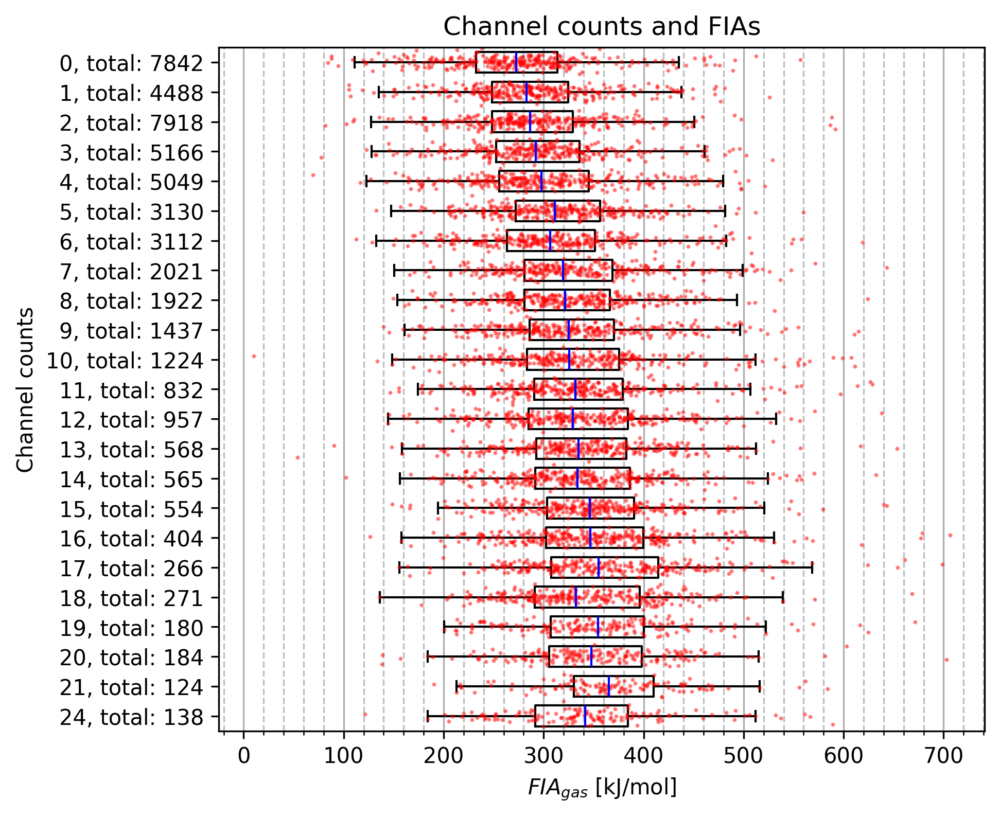

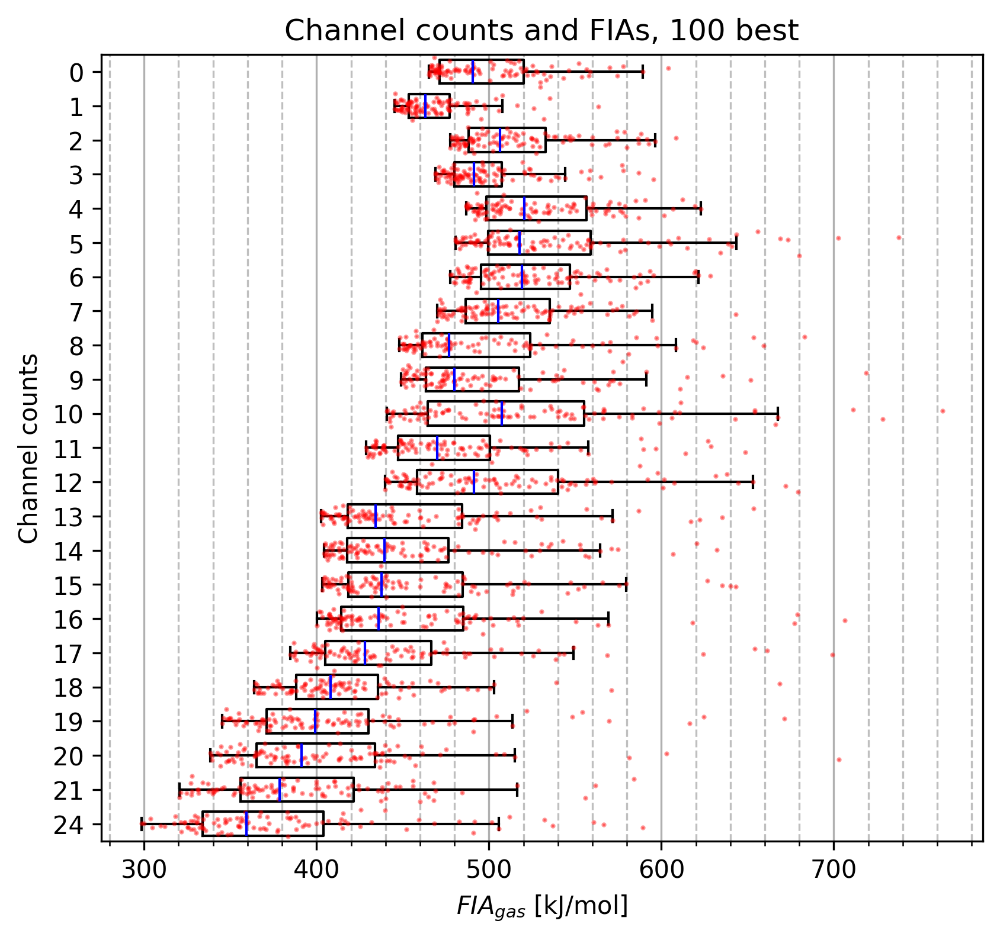

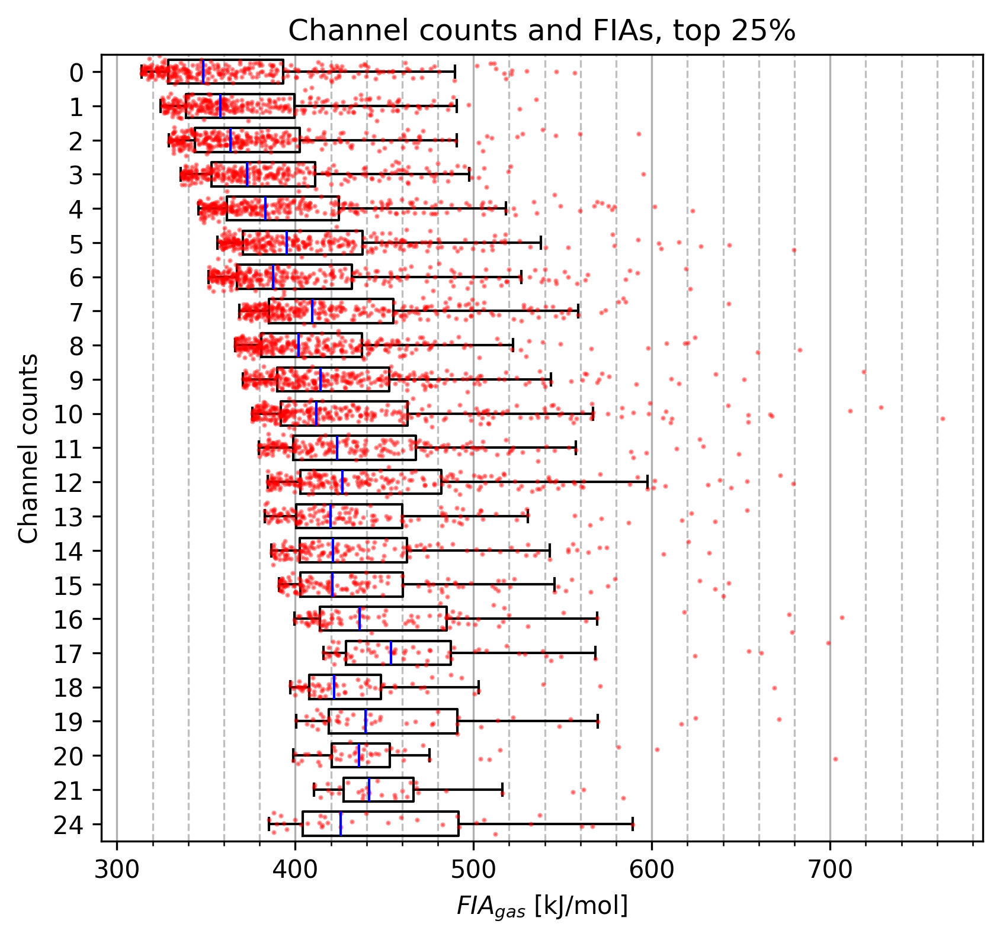

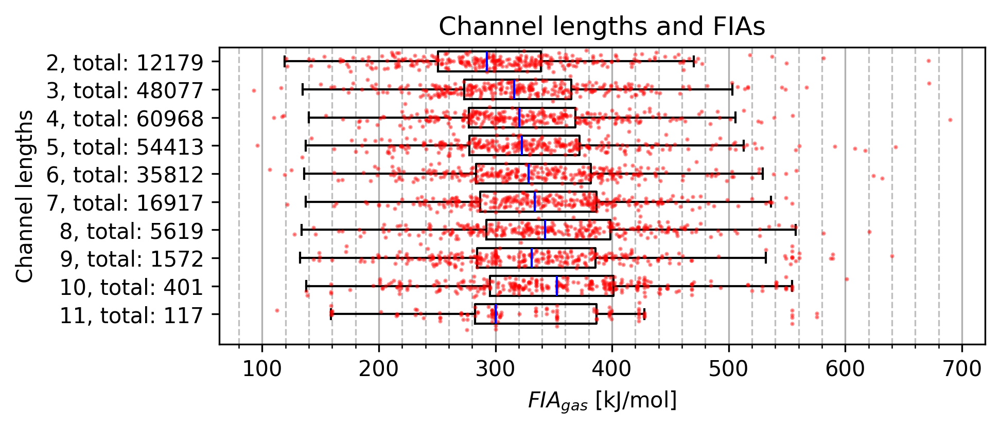

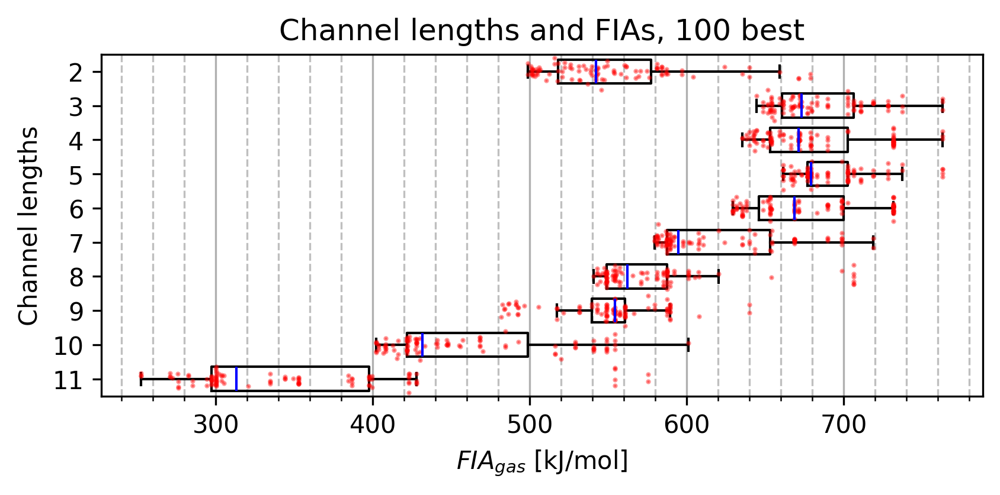

...

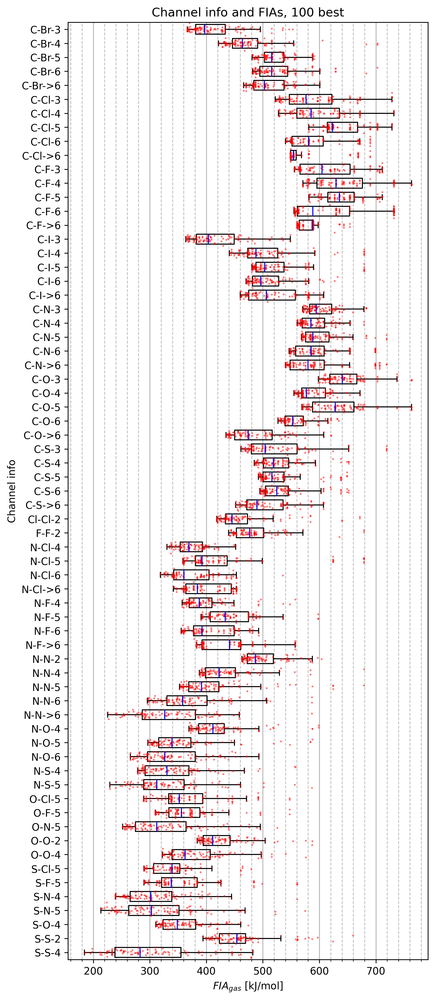

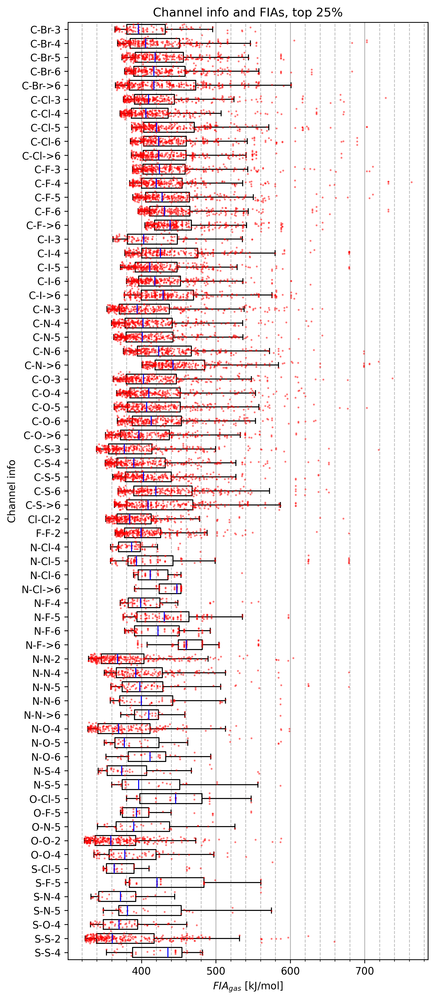

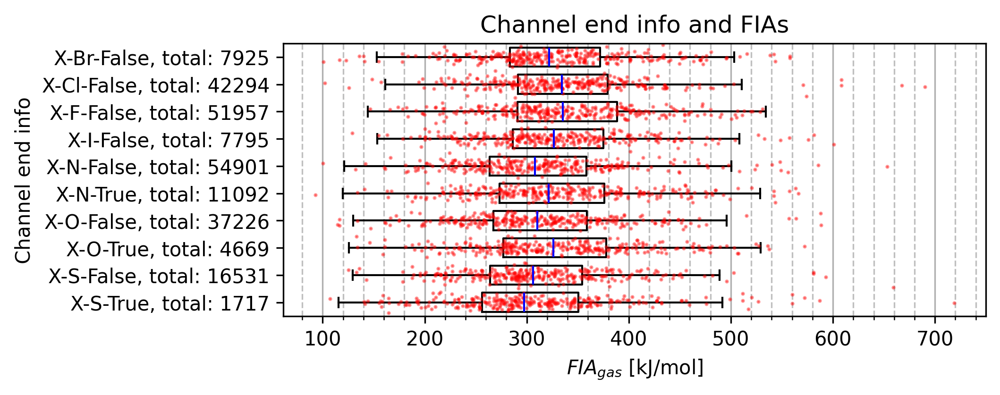

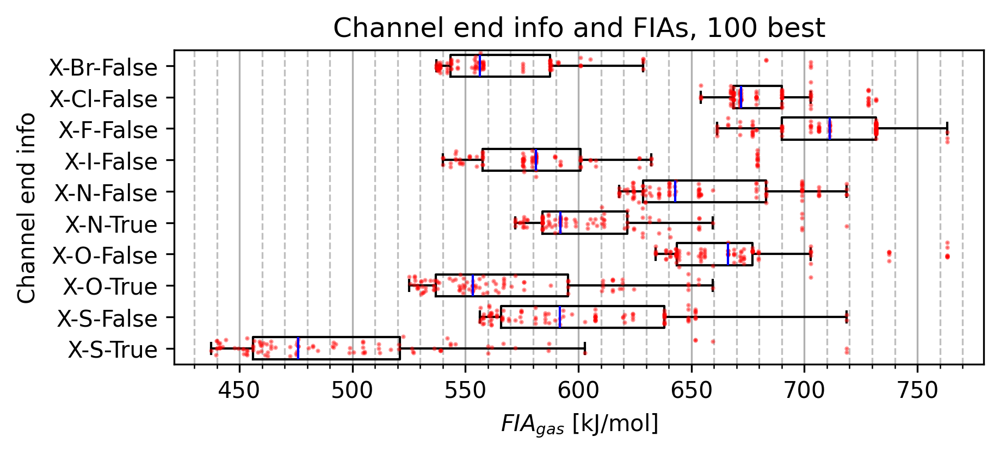

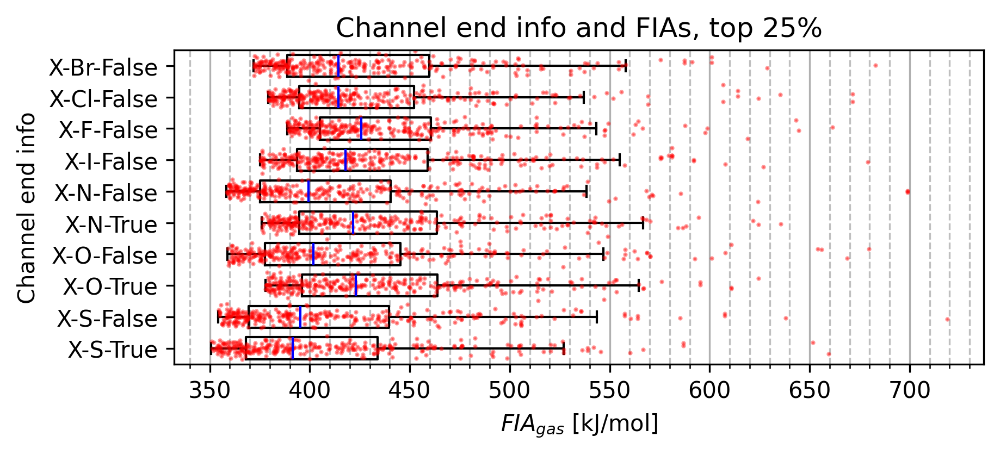

In [19]:
with open('FIA49k.csv', newline='') as file:
    reader = csv.DictReader(file)
    info = get_info_by("channel_count", reader, fetch_fia_only = True)
    
# drop classes with less than BEST occurrences
info = {k: v for k, v in info.items() if not len(v) < BEST}
info_best = deepcopy(info)
info_top = deepcopy(info)
for k, v in info_best.items():
    info_best[k] = v[:BEST]
for k, v in info_top.items():
    info_top[k] = v[:int(len(v) * TOP)]

draw_boxplots(
    info.values(),
    [f"{k}, total: {len(v)}" for k, v in info.items()],
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Channel counts",
    "Channel counts and FIAs",
    save_as = "chan_counts",
)

draw_boxplots(
    info_best.values(),
    info_best.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Channel counts",
    f"Channel counts and FIAs, {BEST} best",
    save_as = "chan_counts_best",
)

draw_boxplots(
    info_top.values(),
    info_top.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Channel counts",
    f"Channel counts and FIAs, top {int(TOP * 100)}%",
    save_as = "chan_counts_best",
)
with open('FIA49k.csv', newline='') as file:
    reader = csv.DictReader(file)
    info = get_info_by("channel_length", reader, fetch_fia_only = True)
    
# drop classes with less than BEST occurrences
info = {k: v for k, v in info.items() if not len(v) < BEST}
info_best = deepcopy(info)
info_top = deepcopy(info)
for k, v in info_best.items():
    info_best[k] = v[:BEST]
for k, v in info_top.items():
    info_top[k] = v[:int(len(v) * TOP)]

draw_boxplots(
    info.values(),
    [f"{k}, total: {len(v)}" for k, v in info.items()],
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Channel lengths",
    "Channel lengths and FIAs",
    save_as = "chan_lengths",
)

draw_boxplots(
    info_best.values(),
    info_best.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Channel lengths",
    f"Channel lengths and FIAs, {BEST} best",
    save_as = "chan_lenghts_best",
)

draw_boxplots(
    info_top.values(),
    info_top.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Channel lengths",
    f"Channel lengths and FIAs, top {int(TOP * 100)}%",
    save_as = "chan_lenghts_top",
)
with open('FIA49k.csv', newline='') as file:
    reader = csv.DictReader(file)
    info = get_info_by("channel_conjugated", reader, fetch_fia_only = True)
    
# drop classes with less than BEST occurrences
info = {k: v for k, v in info.items() if not len(v) < BEST}
info_best = deepcopy(info)
info_top = deepcopy(info)
for k, v in info_best.items():
    info_best[k] = v[:BEST]
for k, v in info_top.items():
    info_top[k] = v[:int(len(v) * TOP)]

draw_boxplots(
    info.values(),
    [f"{k}, total: {len(v)}" for k, v in info.items()],
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Channel conjugated",
    "Channel conjugation status and FIAs",
    save_as = "chan_conj",
)

draw_boxplots(
    info_best.values(),
    info_best.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Channel conjugated",
    f"Channel conjugation status and FIAs, {BEST} best",
    save_as = "chan_conj_best",
)

draw_boxplots(
    info_top.values(),
    info_top.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Channel conjugated",
    f"Channel conjugation status and FIAs, top {int(TOP * 100)}%",
    save_as = "chan_conj_top",
)

with open('FIA49k.csv', newline='') as file:
    reader = csv.DictReader(file)
    info = get_info_by("channel_aromatic", reader, fetch_fia_only = True)
    
# drop classes with less than BEST occurrences
info = {k: v for k, v in info.items() if not len(v) < BEST}
info_best = deepcopy(info)
info_top = deepcopy(info)
for k, v in info_best.items():
    info_best[k] = v[:BEST]
for k, v in info_top.items():
    info_top[k] = v[:int(len(v) * TOP)]

draw_boxplots(
    info.values(),
    [f"{k}, total: {len(v)}" for k, v in info.items()],
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Channel aromatic",
    "Channel aromaticity status and FIAs",
    save_as = "chan_arom",
)
    
draw_boxplots(
    info_best.values(),
    info_best.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Channel aromatic",
    f"Channel aromaticity status and FIAs, {BEST} best",
    save_as = "chan_arom_best",
)

draw_boxplots(
    info_top.values(),
    info_top.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Channel aromatic",
    f"Channel aromaticity status and FIAs, top {int(TOP * 100)}%",
    save_as = "chan_arom_top",
)
with open('FIA49k.csv', newline='') as file:
    reader = csv.DictReader(file)
    info = get_info_by("channel_start_end_info", reader, fetch_fia_only = True)
    
# drop classes with less than BEST occurrences
info = {k: v for k, v in info.items() if not len(v) < BEST}
info_best = deepcopy(info)
info_top = deepcopy(info)
for k, v in info_best.items():
    info_best[k] = v[:BEST]
for k, v in info_top.items():
    info_top[k] = v[:int(len(v) * TOP)]

draw_boxplots(
    info.values(),
    [f"{k}, total: {len(v)}" for k, v in info.items()],
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Channel info",
    "Channel info and FIAs",
    save_as = "chan_info",
)
    
draw_boxplots(
    info_best.values(),
    info_best.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Channel info",
    f"Channel info and FIAs, {BEST} best",
    save_as = "chan_info_best",
)

draw_boxplots(
    info_top.values(),
    info_top.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Channel info",
    f"Channel info and FIAs, top {int(TOP * 100)}%",
    save_as = "chan_info_top",
)

with open('FIA49k.csv', newline='') as file:
    reader = csv.DictReader(file)
    info = get_info_by("channel_end_info", reader, fetch_fia_only = True)
    
# drop classes with less than BEST occurrences
info = {k: v for k, v in info.items() if not len(v) < BEST}
info_best = deepcopy(info)
info_top = deepcopy(info)
for k, v in info_best.items():
    info_best[k] = v[:BEST]
for k, v in info_top.items():
    info_top[k] = v[:int(len(v) * TOP)]

draw_boxplots(
    info.values(),
    [f"{k}, total: {len(v)}" for k, v in info.items()],
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Channel end info",
    "Channel end info and FIAs",
    save_as = "chan_end_info",
)
    
draw_boxplots(
    info_best.values(),
    info_best.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Channel end info",
    f"Channel end info and FIAs, {BEST} best",
    save_as = "chan_end_info_best",
)

draw_boxplots(
    info_top.values(),
    info_top.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Channel end info",
    f"Channel end info and FIAs, top {int(TOP * 100)}%",
    save_as = "chan_end_info_top",
)

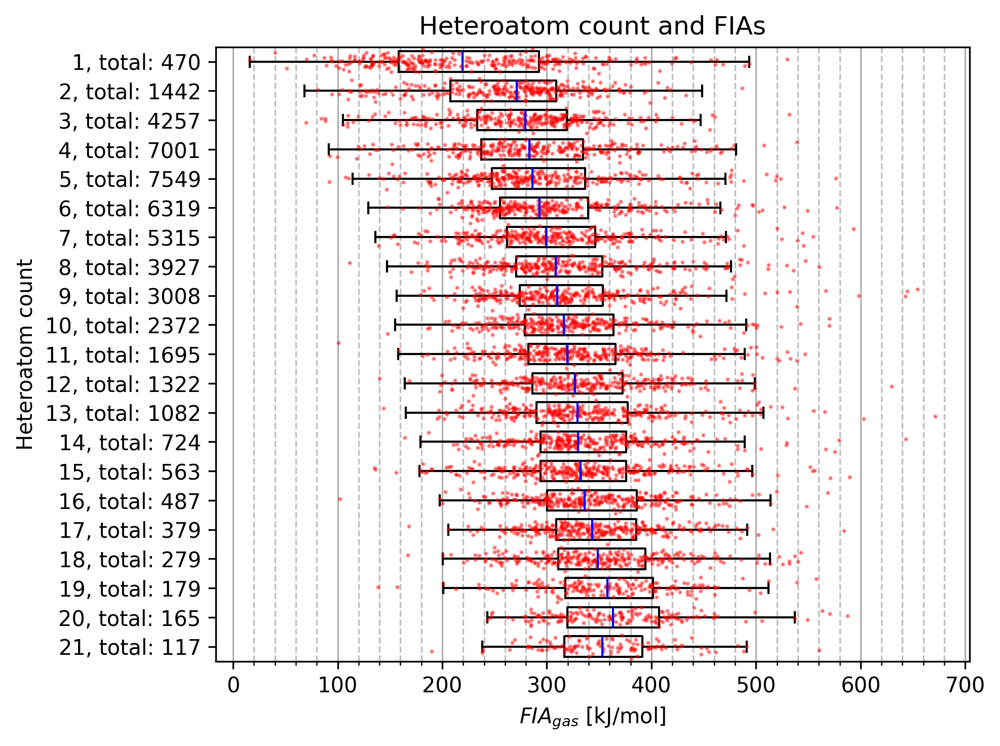

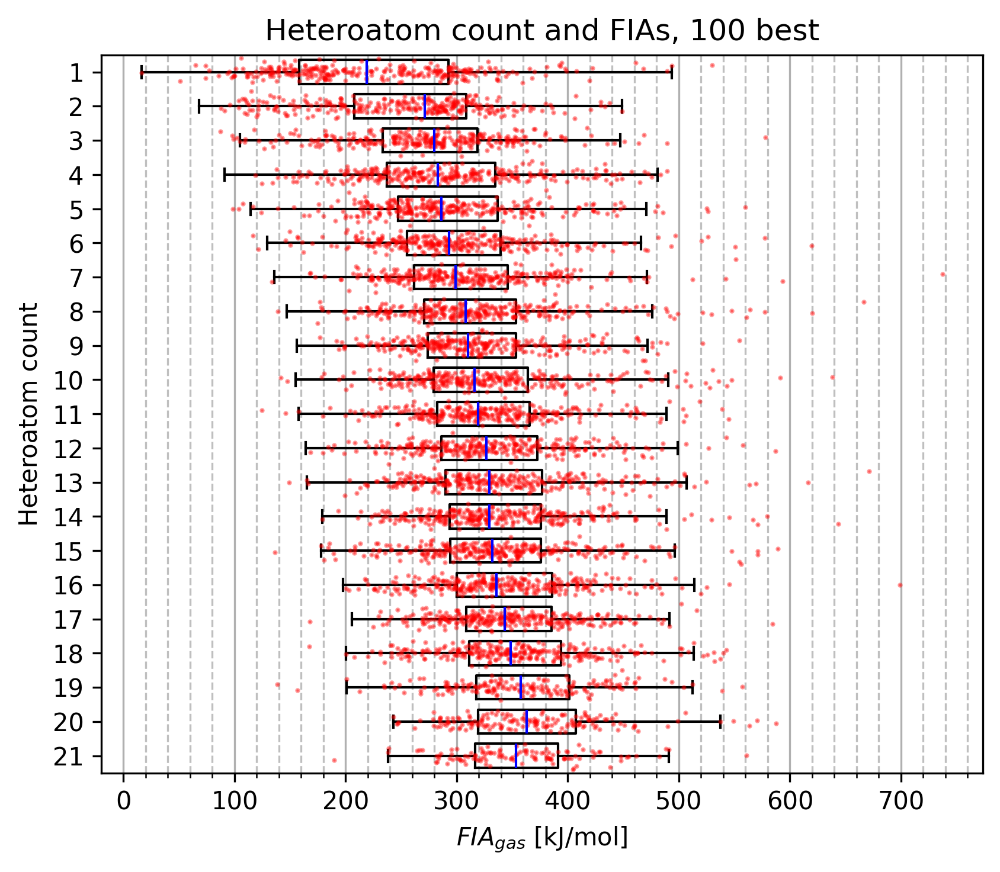

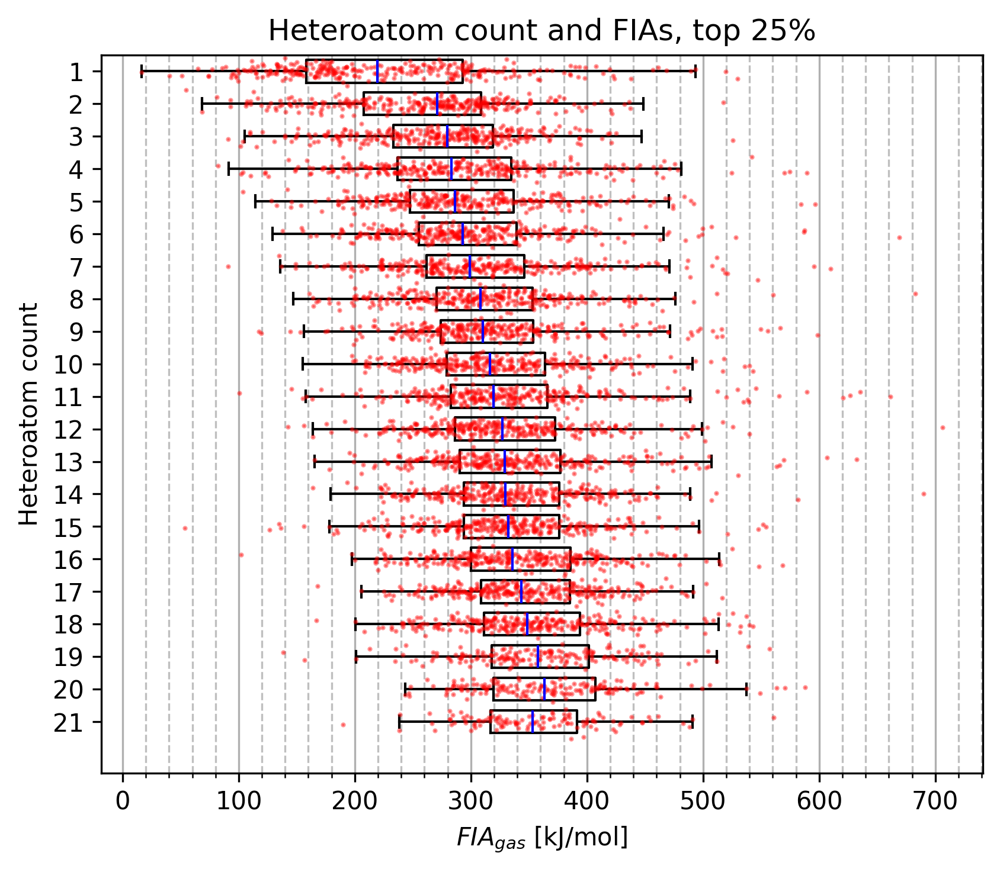

In [24]:
with open('FIA49k.csv', newline='') as file:
    reader = csv.DictReader(file)
    info = get_info_by("heteroatom_count", reader, fetch_fia_only = True)
    
# drop classes with less than BEST occurrences
info = {k: v for k, v in info.items() if not len(v) < BEST}
info_best = deepcopy(info)
info_top = deepcopy(info)
for k, v in info_best.items():
    info_best[k] = v[:BEST]
for k, v in info_top.items():
    info_top[k] = v[:int(len(v) * TOP)]

draw_boxplots(
    info.values(),
    [f"{k}, total: {len(v)}" for k, v in info.items()],
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Heteroatom count",
    "Heteroatom count and FIAs",
    save_as = "heteroatom_count",
)

draw_boxplots(
    info.values(),
    info.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Heteroatom count",
    "Heteroatom count and FIAs, 100 best",
    save_as = "heteroatom_count_best",
)

draw_boxplots(
    info.values(),
    info.keys(),
    fr"$FIA_{{{CURR_FIA_TYPE}}}$ [kJ/mol]",
    "Heteroatom count",
    f"Heteroatom count and FIAs, top {int(TOP * 100)}%",
    save_as = "heteroatom_count_top",
)
